In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from upsetplot import from_contents
from upsetplot import UpSet
import scanpy as sc
import anndata as ad
import os
from os.path import join

# Feature Selection HLCA Analaysis

In [2]:
# get paths
outputs_pipeline_path = "/lustre/groups/ml01/code/luke.zappia/atlas-feature-selection-benchmark/output/benchmark/"
datasets = "datasets-prepped/"
integration_models = "integration-models/"
selected_features = "selected-features/"

In [3]:
# load metric results
metric_summaries_hlca = pd.read_table('/home/icb/raphael.kfuri-rubens/notebooks/feature_selection/metric-summaries-hlca.tsv')
metrics_hlca = pd.read_table('/home/icb/raphael.kfuri-rubens/notebooks/feature_selection/metrics-hlca.tsv')

In [46]:
metric_summaries_hlca

,Dataset,Method,Integration,Classification,IntegrationBatch,IntegrationBio,Mapping,Unseen,Overall
0,HLCA,Brennecke,Symphony-1,0.667055,0.028384,0.955870,-0.555733,1.172602,0.460051
1,HLCA,Brennecke,scANVI-1,0.886745,0.025096,1.100785,-0.075868,1.588017,0.681286
2,HLCA,Brennecke,scVI-1,0.851045,0.169766,0.741238,0.149598,0.996129,0.560546
3,HLCA,TFs,Symphony-1,0.331869,0.356532,0.352574,0.092776,0.801706,0.381668
4,HLCA,TFs,scANVI-1,0.449464,0.282766,0.659427,-0.005367,0.616375,0.412293
...,...,...,...,...,...,...,...,...,...
229,HLCAImmune,triku,scANVI-1,1.000131,-0.046616,1.470909,-0.169661,1.526392,0.748884
230,HLCAImmune,triku,scVI-1,0.989476,0.331780,0.984232,0.112397,0.894681,0.661762
231,HLCAImmune,wilcoxon,Symphony-1,0.969880,-0.354989,0.760000,-0.166248,1.041619,0.408794
232,HLCAImmune,wilcoxon,scANVI-1,1.040821,-0.039893,1.512895,-0.112218,1.667301,0.800901


In [4]:
# subset to scVI model results
metric_summaries_scvi = metric_summaries_hlca[metric_summaries_hlca['Integration'] == 'scVI-1'].copy()
metric_summaries_scvi

,Dataset,Method,Integration,Classification,IntegrationBatch,IntegrationBio,Mapping,Unseen,Overall
2,HLCA,Brennecke,scVI-1,0.851045,0.169766,0.741238,0.149598,0.996129,0.560546
5,HLCA,TFs,scVI-1,0.374343,0.531101,0.644767,0.298067,0.411693,0.474651
8,HLCA,all,scVI-1,0.841721,0.024077,0.560634,0.068982,0.673970,0.410290
11,HLCA,dubstepr,scVI-1,0.750363,0.083382,0.850819,0.174155,0.798265,0.520681
14,HLCA,hotspot,scVI-1,0.615364,0.288063,0.595988,0.083951,0.692101,0.452915
...,...,...,...,...,...,...,...,...,...
221,HLCAImmune,singleCellHaystack,scVI-1,1.018412,0.059347,0.893188,0.096788,1.060433,0.600739
224,HLCAImmune,statistic-mean-N2000,scVI-1,0.810695,0.073899,0.689476,-0.019898,0.466623,0.400414
227,HLCAImmune,statistic-variance-N2000,scVI-1,0.862826,0.104631,0.789573,0.032343,0.518941,0.459236
230,HLCAImmune,triku,scVI-1,0.989476,0.331780,0.984232,0.112397,0.894681,0.661762


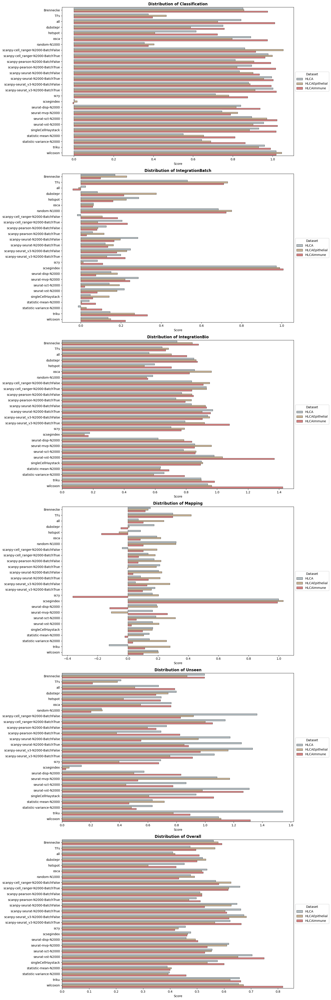

In [6]:
# visualize scVI results
metric_summaries_scvi = metric_summaries_scvi.drop(labels='Integration', axis=1)

melted_df = metric_summaries_scvi.melt(id_vars=['Dataset', 'Method'], var_name='Metric', value_name='Score')

metrics = melted_df['Metric'].unique()
datasets = melted_df['Dataset'].unique()

nice_colors = ['#B0BEC5', '#D2B48C', '#E57373']

fig, axes = plt.subplots(nrows=len(metrics), figsize=(15, 45)) 

for i, metric in enumerate(metrics):
    ax = axes[i]
    subset = melted_df[melted_df['Metric'] == metric]
    sns.barplot(
        data=subset, x='Score', y='Method', hue='Dataset',
        orient='h', ax=ax, palette=nice_colors, edgecolor='black',
        linewidth=0.5
    )
    ax.set_title(f'Distribution of {metric}', fontweight='bold')
    ax.set_xlabel('Score')
    ax.set_ylabel('')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5), title='Dataset')


plt.tight_layout()
plt.show()

In [7]:
# get method ranking
rankings_dict = {}

for i, dataset in enumerate(datasets):
    for j, metric in enumerate(metrics):
        subset = metric_summaries_scvi[metric_summaries_scvi['Dataset'] == dataset][['Method', metric]]
        subset_sorted = subset.sort_values(metric, ascending=False)
        rankings_dict[(dataset + '_' + metric)] = subset_sorted['Method'].tolist()

rankings_dict

{'HLCA_Classification': ['wilcoxon',
  'scanpy-seurat_v3-N2000-BatchTrue',
  'scanpy-seurat-N2000-BatchTrue',
  'scanpy-cell_ranger-N2000-BatchTrue',
  'triku',
  'seurat-vst-N2000',
  'singleCellHaystack',
  'seurat-sct-N2000',
  'scanpy-pearson-N2000-BatchTrue',
  'osca',
  'scanpy-seurat_v3-N2000-BatchFalse',
  'scanpy-cell_ranger-N2000-BatchFalse',
  'Brennecke',
  'all',
  'seurat-disp-N2000',
  'scanpy-seurat-N2000-BatchFalse',
  'scanpy-pearson-N2000-BatchFalse',
  'dubstepr',
  'seurat-mvp-N2000',
  'scry',
  'statistic-variance-N2000',
  'hotspot',
  'statistic-mean-N2000',
  'TFs',
  'random-N1000',
  'scsegindex'],
 'HLCA_IntegrationBatch': ['scsegindex',
  'random-N1000',
  'TFs',
  'hotspot',
  'seurat-mvp-N2000',
  'scanpy-seurat-N2000-BatchFalse',
  'scanpy-seurat_v3-N2000-BatchFalse',
  'seurat-vst-N2000',
  'scanpy-cell_ranger-N2000-BatchTrue',
  'scanpy-seurat_v3-N2000-BatchTrue',
  'Brennecke',
  'seurat-disp-N2000',
  'triku',
  'seurat-sct-N2000',
  'wilcoxon',
  '

In [8]:
# make selected feature dict
feature_files = os.listdir(outputs_pipeline_path + '/' + selected_features + 'HLCA')

selected_feature_dict = {}

for file in feature_files:
    dict_temp = {}
    for dataset in datasets:
        df = pd.read_table(outputs_pipeline_path + '/' + selected_features + dataset + '/' + file)
        dict_temp[dataset] = df['Feature'].tolist()
        selected_feature_dict[file.split('.')[0]] = dict_temp


selected_feature_dict

{'random_N2000_S5': {'HLCA': ['PPM1H',
   'TESMIN',
   'GHITM',
   'LINC01545',
   'MYOM3',
   'RP5-955M13.4',
   'DCDC1',
   'FYTTD1',
   'GJA5',
   'CTD-2349P21.5',
   'LRP3',
   'AC011247.3',
   'RP11-111K18.1',
   'SIN3B',
   'NELFCD',
   'HAMP',
   'ZFP3',
   'OAS2',
   'CDH5',
   'SCAMP1',
   'CTD-2325P2.4',
   'PIWIL2',
   'CDHR4',
   'MTUS2',
   'C4BPB',
   'LINC01983',
   'CTC-529I10.2',
   'RP11-329B9.4',
   'RP11-337N6.2',
   'LINC02122',
   'TNFSF13',
   'TALDO1',
   'SLC25A29',
   'MESTIT1',
   'VILL',
   'SATB1',
   'AC010082.2',
   'KDM2B-DT',
   'C9orf147',
   'S100Z',
   'WDR7',
   'RP11-7N14.1',
   'CTB-50L17.5',
   'RP4-536B24.3',
   'LINC02832',
   'AC009264.1',
   'CEP89',
   'MYPN',
   'MBD5',
   'AP000704.5',
   'OLIG2',
   'RNF152',
   'TFPI',
   'LNCSRLR',
   'NIF3L1',
   'HTR3B',
   'RP11-1057B6.1',
   'LINC02202',
   'FAM174B',
   'FAM225A',
   'RP13-317D12.3',
   'ZFAND2A-DT',
   'IL27',
   'TLX2',
   'BMP6',
   'PLEKHA6',
   'TREML1',
   'RP11-631F7.2',
   

# First visualisation with upset plots

/home/icb/raphael.kfuri-rubens/miniconda3/envs/feature-selection-env/lib/python3.10/site-packages/upsetplot/data.py:385: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df.fillna(False, inplace=True)
/home/icb/raphael.kfuri-rubens/miniconda3/envs/feature-selection-env/lib/python3.10/site-packages/upsetplot/plotting.py:795: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to p

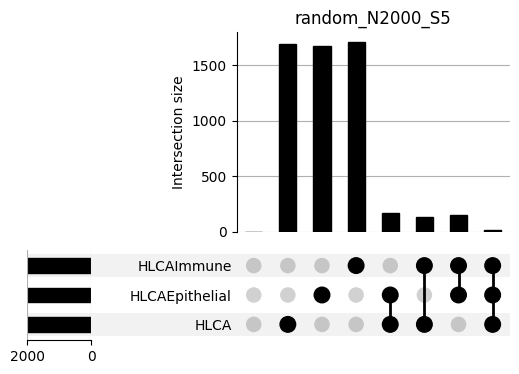

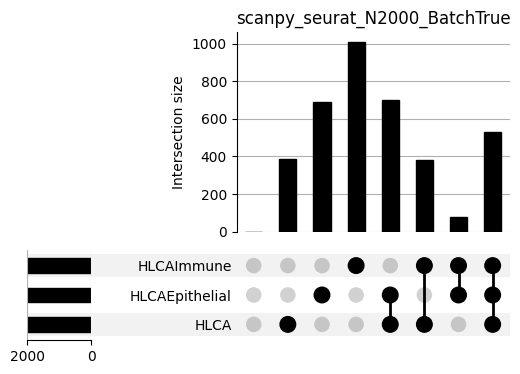

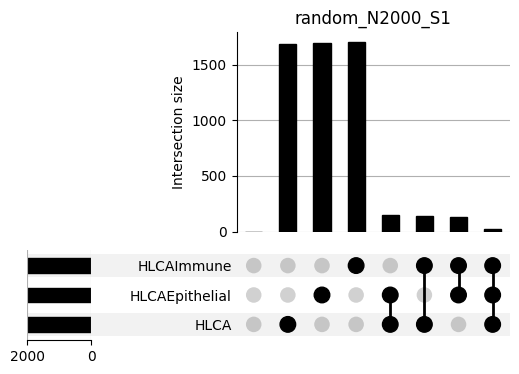

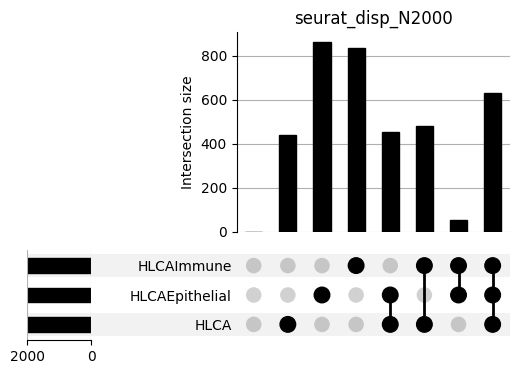

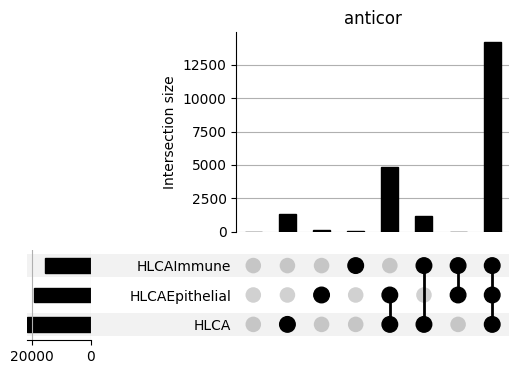

...

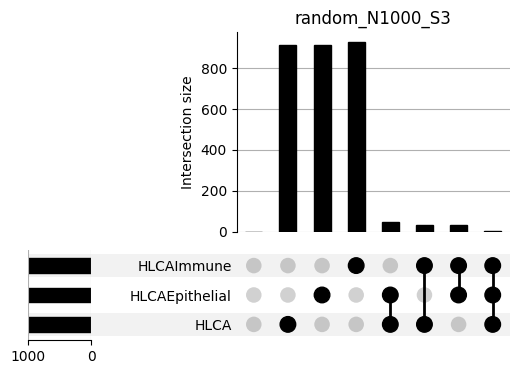

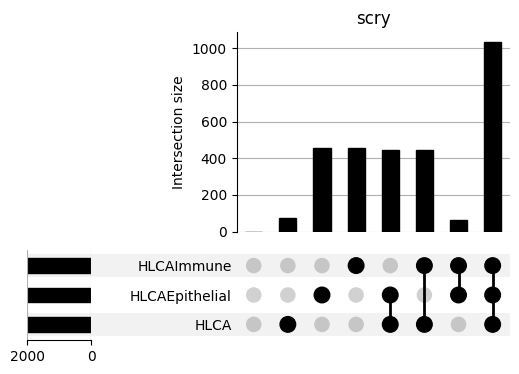

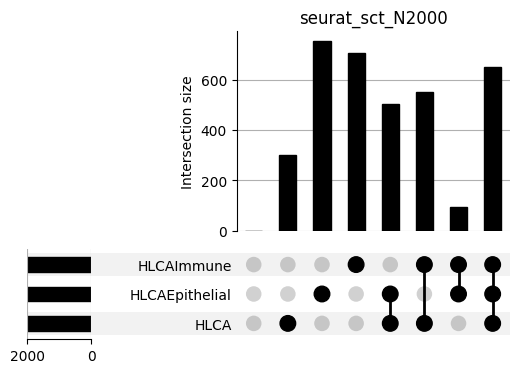

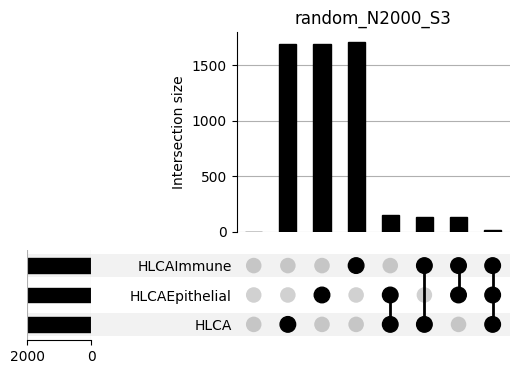

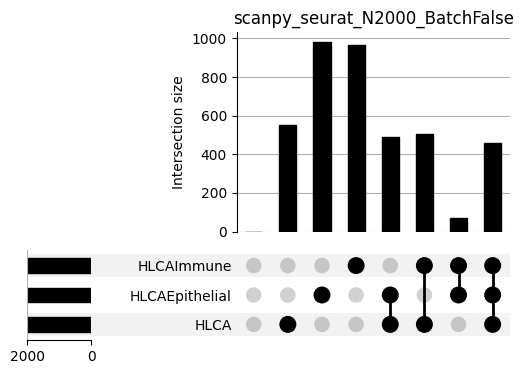

In [63]:
# first coarse visualization with upsetplots
for file in feature_files:
    method_name = file.split('.')[0]
    temp_method = selected_feature_dict[method_name]
    method_conv = from_contents(temp_method)
    UpSet(method_conv, subset_size="count", include_empty_subsets = True).plot()
    plt.title(method_name)

In [9]:
rankings_df = pd.DataFrame(rankings_dict)
rankings_df

,HLCA_Classification,HLCA_IntegrationBatch,HLCA_IntegrationBio,HLCA_Mapping,HLCA_Unseen,HLCA_Overall,HLCAEpithelial_Classification,HLCAEpithelial_IntegrationBatch,HLCAEpithelial_IntegrationBio,HLCAEpithelial_Mapping,HLCAEpithelial_Unseen,HLCAEpithelial_Overall,HLCAImmune_Classification,HLCAImmune_IntegrationBatch,HLCAImmune_IntegrationBio,HLCAImmune_Mapping,HLCAImmune_Unseen,HLCAImmune_Overall
0,wilcoxon,scsegindex,seurat-vst-N2000,scsegindex,triku,seurat-vst-N2000,scanpy-cell_ranger-N2000-BatchFalse,scsegindex,seurat-vst-N2000,scsegindex,seurat-mvp-N2000,scanpy-seurat_v3-N2000-BatchFalse,seurat-vst-N2000,scsegindex,wilcoxon,scsegindex,wilcoxon,wilcoxon
1,scanpy-seurat_v3-N2000-BatchTrue,random-N1000,scanpy-seurat-N2000-BatchTrue,random-N1000,scanpy-cell_ranger-N2000-BatchFalse,scanpy-seurat_v3-N2000-BatchFalse,wilcoxon,random-N1000,wilcoxon,TFs,scanpy-seurat_v3-N2000-BatchFalse,wilcoxon,seurat-sct-N2000,random-N1000,seurat-vst-N2000,TFs,seurat-vst-N2000,seurat-vst-N2000
2,scanpy-seurat-N2000-BatchTrue,TFs,scanpy-seurat_v3-N2000-BatchFalse,TFs,scanpy-seurat_v3-N2000-BatchFalse,scanpy-seurat-N2000-BatchTrue,scanpy-cell_ranger-N2000-BatchTrue,TFs,seurat-mvp-N2000,random-N1000,wilcoxon,seurat-vst-N2000,scanpy-seurat_v3-N2000-BatchTrue,TFs,scanpy-seurat_v3-N2000-BatchTrue,seurat-mvp-N2000,singleCellHaystack,scanpy-seurat_v3-N2000-BatchTrue
3,scanpy-cell_ranger-N2000-BatchTrue,hotspot,wilcoxon,scanpy-pearson-N2000-BatchTrue,seurat-vst-N2000,scanpy-cell_ranger-N2000-BatchTrue,seurat-sct-N2000,dubstepr,osca,seurat-sct-N2000,scanpy-cell_ranger-N2000-BatchTrue,scanpy-seurat-N2000-BatchFalse,singleCellHaystack,triku,triku,scanpy-seurat-N2000-BatchTrue,scanpy-cell_ranger-N2000-BatchTrue,triku
4,triku,seurat-mvp-N2000,scanpy-cell_ranger-N2000-BatchTrue,scanpy-seurat-N2000-BatchFalse,scanpy-seurat-N2000-BatchTrue,triku,scanpy-seurat-N2000-BatchTrue,triku,scanpy-seurat_v3-N2000-BatchFalse,triku,seurat-vst-N2000,scanpy-cell_ranger-N2000-BatchFalse,wilcoxon,seurat-mvp-N2000,scanpy-seurat-N2000-BatchTrue,scanpy-seurat_v3-N2000-BatchFalse,Brennecke,scanpy-seurat_v3-N2000-BatchFalse
5,seurat-vst-N2000,scanpy-seurat-N2000-BatchFalse,singleCellHaystack,wilcoxon,scanpy-seurat-N2000-BatchFalse,wilcoxon,triku,scanpy-seurat_v3-N2000-BatchFalse,scanpy-cell_ranger-N2000-BatchFalse,scanpy-seurat_v3-N2000-BatchFalse,scanpy-seurat-N2000-BatchFalse,triku,scanpy-pearson-N2000-BatchTrue,scanpy-cell_ranger-N2000-BatchTrue,scanpy-seurat-N2000-BatchFalse,Brennecke,scanpy-seurat_v3-N2000-BatchFalse,scanpy-cell_ranger-N2000-BatchTrue
6,singleCellHaystack,scanpy-seurat_v3-N2000-BatchFalse,triku,osca,scanpy-cell_ranger-N2000-BatchTrue,scanpy-seurat-N2000-BatchFalse,scanpy-seurat_v3-N2000-BatchTrue,Brennecke,scanpy-cell_ranger-N2000-BatchTrue,statistic-variance-N2000,scanpy-cell_ranger-N2000-BatchFalse,scanpy-cell_ranger-N2000-BatchTrue,all,wilcoxon,scanpy-cell_ranger-N2000-BatchFalse,triku,scanpy-seurat_v3-N2000-BatchTrue,scanpy-seurat-N2000-BatchTrue
7,seurat-sct-N2000,seurat-vst-N2000,seurat-mvp-N2000,seurat-disp-N2000,wilcoxon,scanpy-seurat_v3-N2000-BatchTrue,scanpy-pearson-N2000-BatchFalse,hotspot,scanpy-seurat-N2000-BatchFalse,all,Brennecke,seurat-mvp-N2000,scanpy-seurat-N2000-BatchTrue,scanpy-seurat_v3-N2000-BatchTrue,scanpy-seurat_v3-N2000-BatchFalse,wilcoxon,triku,singleCellHaystack
8,scanpy-pearson-N2000-BatchTrue,scanpy-cell_ranger-N2000-BatchTrue,osca,seurat-sct-N2000,seurat-mvp-N2000,seurat-mvp-N2000,scanpy-seurat-N2000-BatchFalse,seurat-mvp-N2000,scanpy-seurat_v3-N2000-BatchTrue,scanpy-seurat-N2000-BatchFalse,scanpy-seurat-N2000-BatchTrue,scanpy-seurat-N2000-BatchTrue,scanpy-seurat_v3-N2000-BatchFalse,dubstepr,singleCellHaystack,all,scanpy-seurat-N2000-BatchTrue,Brennecke
9,osca,scanpy-seurat_v3-N2000-BatchTrue,dubstepr,scanpy-seurat_v3-N2000-BatchTrue,scanpy-seurat_v3-N2000-BatchTrue,singleCellHaystack,seurat-vst-N2000,scanpy-seurat-N2000-BatchFalse,singleCellHaystack,scanpy-pearson-N2000-BatchFalse,triku,Brennecke,scanpy-pearson-N2000-BatchFalse,scanp

In [88]:
# transform to ranks
ranked_df = rankings_df.apply(lambda x: x.rank(method='min').astype(int))
ranked_df

,HLCA_Classification,HLCA_IntegrationBatch,HLCA_IntegrationBio,HLCA_Mapping,HLCA_Unseen,HLCA_Overall,HLCAEpithelial_Classification,HLCAEpithelial_IntegrationBatch,HLCAEpithelial_IntegrationBio,HLCAEpithelial_Mapping,HLCAEpithelial_Unseen,HLCAEpithelial_Overall,HLCAImmune_Classification,HLCAImmune_IntegrationBatch,HLCAImmune_IntegrationBio,HLCAImmune_Mapping,HLCAImmune_Unseen,HLCAImmune_Overall
0,26,17,21,17,25,21,8,17,21,17,19,14,21,17,26,17,26,26
1,15,7,13,7,8,14,26,7,26,2,14,26,20,7,21,2,21,21
2,13,2,14,2,14,13,9,2,19,7,26,21,15,2,15,19,22,15
3,9,5,26,11,21,9,20,4,6,20,9,12,22,25,25,13,9,25
4,25,19,9,12,13,25,13,25,14,25,21,8,26,19,13,14,1,14
5,21,12,22,26,12,26,25,14,8,14,12,25,11,9,12,1,14,9
6,22,14,25,6,9,12,15,1,9,24,8,9,3,26,8,25,15,13
7,20,21,19,18,26,15,10,5,12,3,1,19,13,15,14,26,25,22
8,11,9,6,20,19,19,12,19,15,12,13,13,14,4,22,3,13,1
9,6,15,4,15,15,22,21,12,22,10,25,1,10,8,1,7,18,8


# HLCA exploration

In [10]:
# load HLCA data
hlca_file = "datasets-raw/HLCA.h5ad"
adata = sc.read_h5ad(outputs_pipeline_path + hlca_file)
adata

AnnData object with n_obs × n_vars = 584944 × 28024
    obs: 'suspension_type', 'donor_id', 'is_primary_data', 'assay_ontology_term_id', 'cell_type_ontology_term_id', 'development_stage_ontology_term_id', 'disease_ontology_term_id', 'self_reported_ethnicity_ontology_term_id', 'tissue_ontology_term_id', 'organism_ontology_term_id', 'sex_ontology_term_id', 'BMI', 'age_or_mean_of_age_range', 'age_range', 'anatomical_region_ccf_score', 'ann_coarse_for_GWAS_and_modeling', 'ann_finest_level', 'ann_level_1', 'ann_level_2', 'ann_level_3', 'ann_level_4', 'ann_level_5', 'cause_of_death', 'dataset', 'entropy_dataset_leiden_3', 'entropy_original_ann_level_1_leiden_3', 'entropy_original_ann_level_2_clean_leiden_3', 'entropy_original_ann_level_3_clean_leiden_3', 'entropy_subject_ID_leiden_3', 'fresh_or_frozen', 'leiden_1', 'leiden_2', 'leiden_3', 'leiden_4', 'leiden_5', 'log10_total_counts', 'lung_condition', 'mixed_ancestry', 'n_genes_detected', 'original_ann_highest_res', 'original_ann_level_1', '

In [12]:
# normalize and log1p transform
adata.layers["counts"] = adata.X.copy()
sc.pp.normalize_total(adata)
sc.pp.log1p(adata)

In [13]:
# get differentially expressed genes per cell type
sc.tl.rank_genes_groups(adata, groupby="ann_finest_level", method="wilcoxon")

/home/icb/raphael.kfuri-rubens/miniconda3/envs/feature-selection-env/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:431: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "scores"] = scores[global_indices]
/home/icb/raphael.kfuri-rubens/miniconda3/envs/feature-selection-env/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:434: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "pvals"] = pvals[global_indices]
/home/icb/raphael.kfuri-rubens/miniconda3/envs/featu

         Falling back to preprocessing with `sc.pp.pca` and default params.


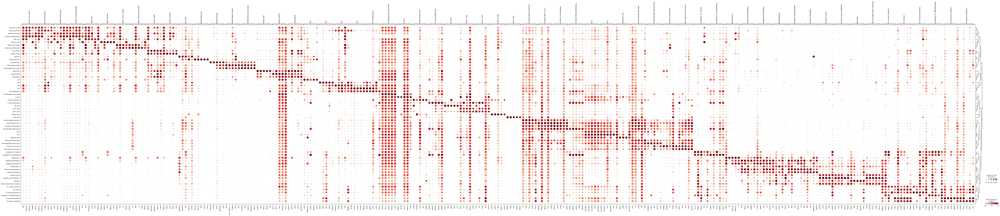

In [9]:
# visualize top 5 genes per cell type
sc.pl.rank_genes_groups_dotplot(
    adata, groupby="ann_finest_level", standard_scale="var", n_genes=5
)

In [14]:
# make dataframe with top 100 DEGs per cell type
cell_types = adata.obs['ann_finest_level'].value_counts().index.tolist()

degs_celltype = []
for cell_type in cell_types:
    df = sc.get.rank_genes_groups_df(adata, group=cell_type).head(100)
    df['cell_type'] = cell_type
    degs_celltype.append(df)

all_degs = pd.concat(degs_celltype, ignore_index = False)

all_degs

,names,scores,logfoldchanges,pvals,pvals_adj,cell_type
0,APOC1,399.069092,5.877395,0.000000e+00,0.000000,Alveolar macrophages
1,C1QB,397.502502,6.035221,0.000000e+00,0.000000,Alveolar macrophages
2,C1QA,395.475952,5.716484,0.000000e+00,0.000000,Alveolar macrophages
3,FTL,390.530090,3.993100,0.000000e+00,0.000000,Alveolar macrophages
4,FABP4,376.791412,6.104146,0.000000e+00,0.000000,Alveolar macrophages
...,...,...,...,...,...,...
95,CDK1,5.676177,5.371634,1.377387e-08,0.000004,Lymphatic EC proliferating
96,CALCRL,5.663761,3.196894,1.480905e-08,0.000004,Lymphatic EC proliferating
97,TAGLN2,5.614377,1.667838,1.972716e-08,0.000006,Lymphatic EC proliferating
98,TIMP1,5.614290,2.353720,1.973712e-08,0.000006,Lymphatic EC proliferating


In [15]:
# get lineage dict to map
cell_type_lineage_dict = {}

for cell_type in cell_types:
    lin = adata[adata.obs['ann_finest_level'] == cell_type].obs['ann_level_1'].value_counts().index[0]
    cell_type_lineage_dict[cell_type] = lin

cell_type_lineage_dict

{'Alveolar macrophages': 'Immune',
 'AT2': 'Epithelial',
 'Suprabasal': 'Epithelial',
 'Basal resting': 'Epithelial',
 'Goblet (nasal)': 'Epithelial',
 'Multiciliated (non-nasal)': 'Epithelial',
 'CD8 T cells': 'Immune',
 'Monocyte-derived Mph': 'Immune',
 'Club (nasal)': 'Epithelial',
 'CD4 T cells': 'Immune',
 'Classical monocytes': 'Immune',
 'NK cells': 'Immune',
 'EC general capillary': 'Endothelial',
 'Adventitial fibroblasts': 'Stroma',
 'Club (non-nasal)': 'Epithelial',
 'DC2': 'Immune',
 'Non-classical monocytes': 'Immune',
 'Alveolar Mph CCL3+': 'Immune',
 'AT1': 'Epithelial',
 'EC arterial': 'Endothelial',
 'EC aerocyte capillary': 'Endothelial',
 'Mast cells': 'Immune',
 'EC venous systemic': 'Endothelial',
 'EC venous pulmonary': 'Endothelial',
 'Alveolar fibroblasts': 'Stroma',
 'Multiciliated (nasal)': 'Epithelial',
 'Interstitial Mph perivascular': 'Immune',
 'Hillock-like': 'Epithelial',
 'B cells': 'Immune',
 'pre-TB secretory': 'Epithelial',
 'Lymphatic EC mature': '

In [16]:
# map lineage
all_degs['lineage'] = all_degs['cell_type'].map(cell_type_lineage_dict)
all_degs

,names,scores,logfoldchanges,pvals,pvals_adj,cell_type,lineage
0,APOC1,399.069092,5.877395,0.000000e+00,0.000000,Alveolar macrophages,Immune
1,C1QB,397.502502,6.035221,0.000000e+00,0.000000,Alveolar macrophages,Immune
2,C1QA,395.475952,5.716484,0.000000e+00,0.000000,Alveolar macrophages,Immune
3,FTL,390.530090,3.993100,0.000000e+00,0.000000,Alveolar macrophages,Immune
4,FABP4,376.791412,6.104146,0.000000e+00,0.000000,Alveolar macrophages,Immune
...,...,...,...,...,...,...,...
95,CDK1,5.676177,5.371634,1.377387e-08,0.000004,Lymphatic EC proliferating,Endothelial
96,CALCRL,5.663761,3.196894,1.480905e-08,0.000004,Lymphatic EC proliferating,Endothelial
97,TAGLN2,5.614377,1.667838,1.972716e-08,0.000006,Lymphatic EC proliferating,Endothelial
98,TIMP1,5.614290,2.353720,1.973712e-08,0.000006,Lymphatic EC proliferating,Endothelial


In [42]:
# save top 100 DEGs per cell type
all_degs.to_csv("/home/icb/raphael.kfuri-rubens/notebooks/feature_selection/top_100_degs_cell_types_hlca.tsv", sep='\t', index=False)

In [17]:
# add DEG ranking for internal control
array=np.arange(100)
vector=np.tile(array, 61)
all_degs['ranking'] = vector

all_degs

,names,scores,logfoldchanges,pvals,pvals_adj,cell_type,lineage,ranking
0,APOC1,399.069092,5.877395,0.000000e+00,0.000000,Alveolar macrophages,Immune,0
1,C1QB,397.502502,6.035221,0.000000e+00,0.000000,Alveolar macrophages,Immune,1
2,C1QA,395.475952,5.716484,0.000000e+00,0.000000,Alveolar macrophages,Immune,2
3,FTL,390.530090,3.993100,0.000000e+00,0.000000,Alveolar macrophages,Immune,3
4,FABP4,376.791412,6.104146,0.000000e+00,0.000000,Alveolar macrophages,Immune,4
...,...,...,...,...,...,...,...,...
95,CDK1,5.676177,5.371634,1.377387e-08,0.000004,Lymphatic EC proliferating,Endothelial,95
96,CALCRL,5.663761,3.196894,1.480905e-08,0.000004,Lymphatic EC proliferating,Endothelial,96
97,TAGLN2,5.614377,1.667838,1.972716e-08,0.000006,Lymphatic EC proliferating,Endothelial,97
98,TIMP1,5.614290,2.353720,1.973712e-08,0.000006,Lymphatic EC proliferating,Endothelial,98


In [18]:
# group by lineage and cell type
all_degs_sorted = all_degs.sort_values(by=['lineage', 'cell_type'], ascending=[True, False])
all_degs_sorted

,names,scores,logfoldchanges,pvals,pvals_adj,cell_type,lineage,ranking
0,STMN1,9.072060,6.003485,1.167886e-19,3.272884e-15,Lymphatic EC proliferating,Endothelial,0
1,TUBB,8.764170,3.945824,1.881581e-18,1.346101e-14,Lymphatic EC proliferating,Endothelial,1
2,CCL21,8.740145,9.465929,2.328125e-18,1.346101e-14,Lymphatic EC proliferating,Endothelial,2
3,TUBA1B,8.732875,3.698761,2.482788e-18,1.346101e-14,Lymphatic EC proliferating,Endothelial,3
4,H2AZ1,8.728191,3.477062,2.587773e-18,1.346101e-14,Lymphatic EC proliferating,Endothelial,4
...,...,...,...,...,...,...,...,...
95,LDHA,105.482918,1.979664,0.000000e+00,0.000000e+00,Adventitial fibroblasts,Stroma,95
96,CCN1,104.438210,3.279207,0.000000e+00,0.000000e+00,Adventitial fibroblasts,Stroma,96
97,PDGFRL,104.000282,7.484183,0.000000e+00,0.000000e+00,Adventitial fibroblasts,Stroma,97
98,IFITM2,103.990768,2.052863,0.000000e+00,0.000000e+00,Adventitial fibroblasts,Stroma,98


In [92]:
# save top 100 DEGs per cell type sorted
all_degs_sorted.to_csv("/home/icb/raphael.kfuri-rubens/notebooks/feature_selection/top_100_degs_cell_types_hlca_sorted.tsv", sep='\t', index=False)

In [19]:
# define functions to calculate jaccard index and overlap index
def jaccard_index(list1, list2):
    set1 = set(list1)
    set2 = set(list2)
    
    intersection = set1.intersection(set2)
    union = set1.union(set2)
    
    if len(union) == 0:
        return 1.0 if len(intersection) == 0 else 0
    jaccard = len(intersection) / len(union)
    return jaccard

def overlap_index(list1_degs, list2_sel_feat):
    set1 = set(list1_degs)
    set2 = set(list2_sel_feat)
    
    intersection = set1.intersection(set2)

    overlap_ind = len(intersection) / len(list1_degs)
    return overlap_ind


### Calculate Jaccard Index between all selected features per method and top 100 DEGs per cell type in HLCA

In [20]:
# Method where immune and epithelial better than full HLCA
#seurat_vst_N2000

methods = [x.split('.')[0] for x in feature_files]
hlca_subsets = list(selected_feature_dict['seurat_vst_N2000'].keys())

jaccard_all = {}

for method in methods:
    jaccard_all_subsets = {}
    for subset in hlca_subsets:
        jaccard_degs_cell_type = {}
        for cell_type in cell_types:
            degs = all_degs_sorted[all_degs_sorted['cell_type'] == cell_type]['names'].tolist()
            jaccard_temp = jaccard_index(degs, selected_feature_dict[method][subset])
            jaccard_degs_cell_type[cell_type] = jaccard_temp
        jaccard_all_subsets[subset] = jaccard_degs_cell_type
    jaccard_all[method] = jaccard_all_subsets

jaccard_all

{'random_N2000_S5': {'HLCA': {'Alveolar macrophages': 0.00430416068866571,
   'AT2': 0.002386634844868735,
   'Suprabasal': 0.002386634844868735,
   'Basal resting': 0.0028653295128939827,
   'Goblet (nasal)': 0.002386634844868735,
   'Multiciliated (non-nasal)': 0.0033444816053511705,
   'CD8 T cells': 0.006229036895064686,
   'Monocyte-derived Mph': 0.0033444816053511705,
   'Club (nasal)': 0.002386634844868735,
   'CD4 T cells': 0.005747126436781609,
   'Classical monocytes': 0.002386634844868735,
   'NK cells': 0.005265677357587362,
   'EC general capillary': 0.00430416068866571,
   'Adventitial fibroblasts': 0.0038240917782026767,
   'Club (non-nasal)': 0.0033444816053511705,
   'DC2': 0.004784688995215311,
   'Non-classical monocytes': 0.00430416068866571,
   'Alveolar Mph CCL3+': 0.004784688995215311,
   'AT1': 0.0028653295128939827,
   'EC arterial': 0.004784688995215311,
   'EC aerocyte capillary': 0.00430416068866571,
   'Mast cells': 0.0028653295128939827,
   'EC venous syst

### Calculate Overlap Index between all selected features per method and top 100 DEGs per cell type in HLCA

In [21]:
overlap_all = {}

for method in methods:
    overlap_all_subsets = {}
    for subset in hlca_subsets:
        overlap_degs_cell_type = {}
        for cell_type in cell_types:
            degs = all_degs_sorted[all_degs_sorted['cell_type'] == cell_type]['names'].tolist()
            overlap_temp = overlap_index(degs, selected_feature_dict[method][subset])
            overlap_degs_cell_type[cell_type] = overlap_temp
        overlap_all_subsets[subset] = overlap_degs_cell_type
    overlap_all[method] = overlap_all_subsets

overlap_all

{'random_N2000_S5': {'HLCA': {'Alveolar macrophages': 0.09,
   'AT2': 0.05,
   'Suprabasal': 0.05,
   'Basal resting': 0.06,
   'Goblet (nasal)': 0.05,
   'Multiciliated (non-nasal)': 0.07,
   'CD8 T cells': 0.13,
   'Monocyte-derived Mph': 0.07,
   'Club (nasal)': 0.05,
   'CD4 T cells': 0.12,
   'Classical monocytes': 0.05,
   'NK cells': 0.11,
   'EC general capillary': 0.09,
   'Adventitial fibroblasts': 0.08,
   'Club (non-nasal)': 0.07,
   'DC2': 0.1,
   'Non-classical monocytes': 0.09,
   'Alveolar Mph CCL3+': 0.1,
   'AT1': 0.06,
   'EC arterial': 0.1,
   'EC aerocyte capillary': 0.09,
   'Mast cells': 0.06,
   'EC venous systemic': 0.05,
   'EC venous pulmonary': 0.08,
   'Alveolar fibroblasts': 0.06,
   'Multiciliated (nasal)': 0.05,
   'Interstitial Mph perivascular': 0.07,
   'Hillock-like': 0.08,
   'B cells': 0.1,
   'pre-TB secretory': 0.09,
   'Lymphatic EC mature': 0.07,
   'Pericytes': 0.07,
   'Smooth muscle': 0.05,
   'Plasma cells': 0.08,
   'Goblet (bronchial)': 0

### Convert jaccard score dicts to dfs

In [22]:
rows = []
for method, datasets in jaccard_all.items():
    for dataset, cell_types in datasets.items():
        for cell_type, score in cell_types.items():
            rows.append({
                'method': method,
                'dataset': dataset,
                'cell_type': cell_type,
                'score': score
            })
df = pd.DataFrame(rows)

df['lineage'] = df['cell_type'].map(cell_type_lineage_dict)

df

,method,dataset,cell_type,score,lineage
0,random_N2000_S5,HLCA,Alveolar macrophages,0.004304,Immune
1,random_N2000_S5,HLCA,AT2,0.002387,Epithelial
2,random_N2000_S5,HLCA,Suprabasal,0.002387,Epithelial
3,random_N2000_S5,HLCA,Basal resting,0.002865,Epithelial
4,random_N2000_S5,HLCA,Goblet (nasal),0.002387,Epithelial
...,...,...,...,...,...
7864,scanpy_seurat_N2000_BatchFalse,HLCAImmune,Mesothelium,0.014983,Stroma
7865,scanpy_seurat_N2000_BatchFalse,HLCAImmune,Tuft,0.002387,Epithelial
7866,scanpy_seurat_N2000_BatchFalse,HLCAImmune,Neuroendocrine,0.004304,Epithelial
7867,scanpy_seurat_N2000_BatchFalse,HLCAImmune,Hematopoietic stem cells,0.002387,Immune


### Convert overlap score dicts to dfs

In [23]:
rows_overlap = []
for method, datasets in overlap_all.items():
    for dataset, cell_types in datasets.items():
        for cell_type, score in cell_types.items():
            rows_overlap.append({
                'method': method,
                'dataset': dataset,
                'cell_type': cell_type,
                'score': score
            })
df_overlap = pd.DataFrame(rows_overlap)

df_overlap['lineage'] = df_overlap['cell_type'].map(cell_type_lineage_dict)

df_overlap

,method,dataset,cell_type,score,lineage
0,random_N2000_S5,HLCA,Alveolar macrophages,0.09,Immune
1,random_N2000_S5,HLCA,AT2,0.05,Epithelial
2,random_N2000_S5,HLCA,Suprabasal,0.05,Epithelial
3,random_N2000_S5,HLCA,Basal resting,0.06,Epithelial
4,random_N2000_S5,HLCA,Goblet (nasal),0.05,Epithelial
...,...,...,...,...,...
7864,scanpy_seurat_N2000_BatchFalse,HLCAImmune,Mesothelium,0.31,Stroma
7865,scanpy_seurat_N2000_BatchFalse,HLCAImmune,Tuft,0.05,Epithelial
7866,scanpy_seurat_N2000_BatchFalse,HLCAImmune,Neuroendocrine,0.09,Epithelial
7867,scanpy_seurat_N2000_BatchFalse,HLCAImmune,Hematopoietic stem cells,0.05,Immune


# Plotting of Scores

In [117]:
# define order for the lineages
lineage_order = list(df['lineage'].value_counts().index)
df['lineage'] = pd.Categorical(df['lineage'], categories=lineage_order, ordered=True)

df.sort_values(by=['lineage'], inplace=True)

In [167]:
lineage_colors = {
    'Epithelial': '#E76F51',
    'Immune': '#2A9D8F',
    'Stroma': '#264653',
    'Endothelial': '#F4A261'
}

df['colors'] = df['lineage'].map(lineage_colors)

plt.style.use('seaborn-v0_8-whitegrid')

plt.rcParams.update({
    'axes.edgecolor': 'black',
    'axes.grid': True,
    'grid.color': 'black',
    'grid.linestyle': '-',
    'legend.frameon': True,
    'legend.framealpha': 1,
    'legend.facecolor': 'white'
})

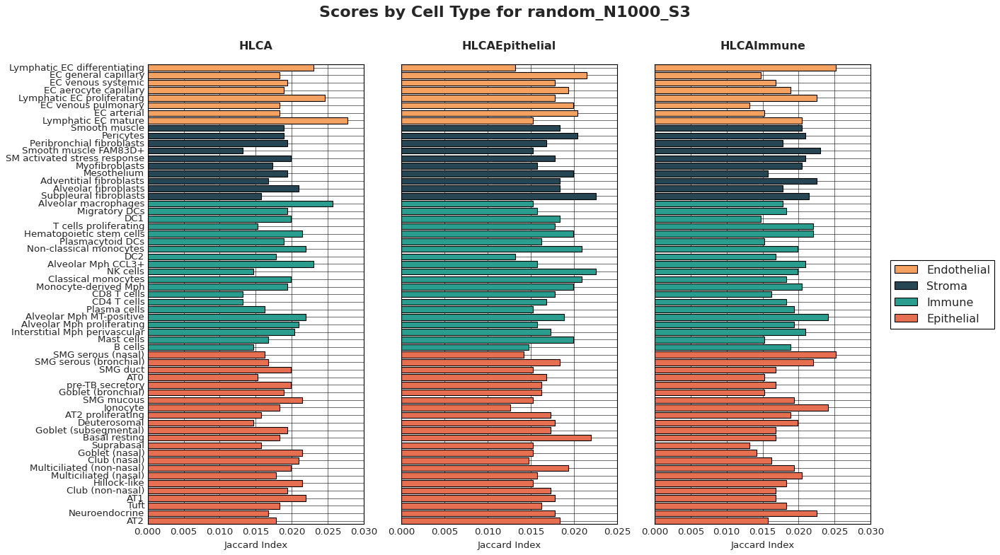

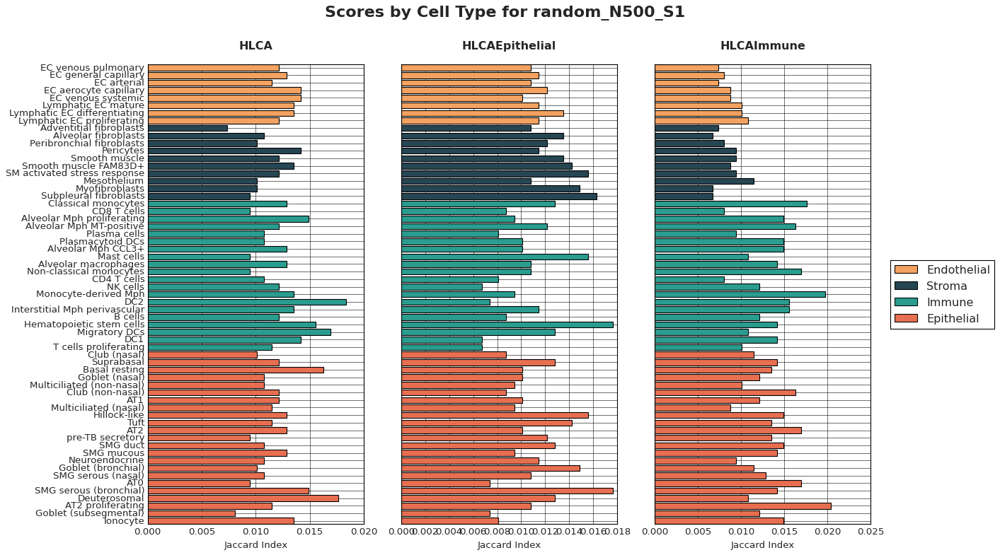

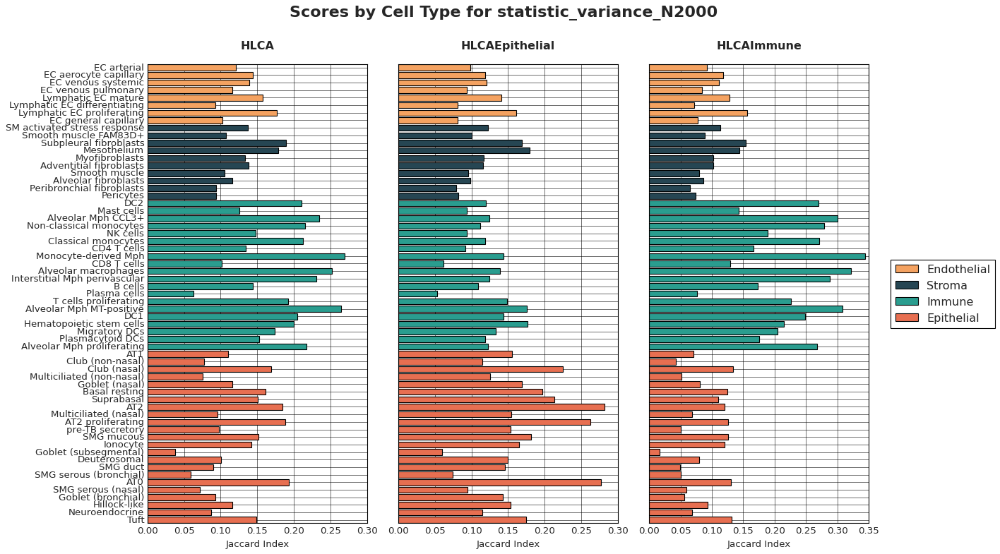

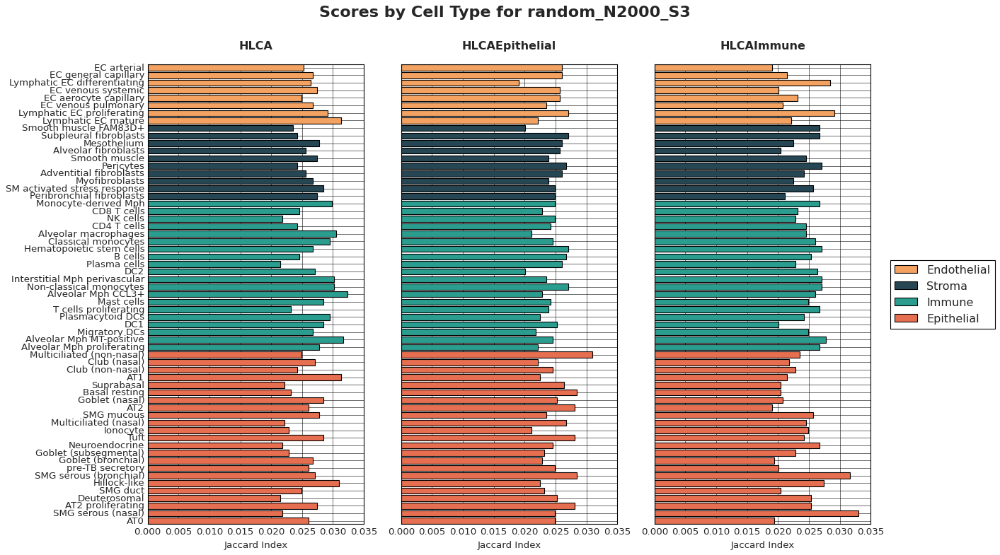

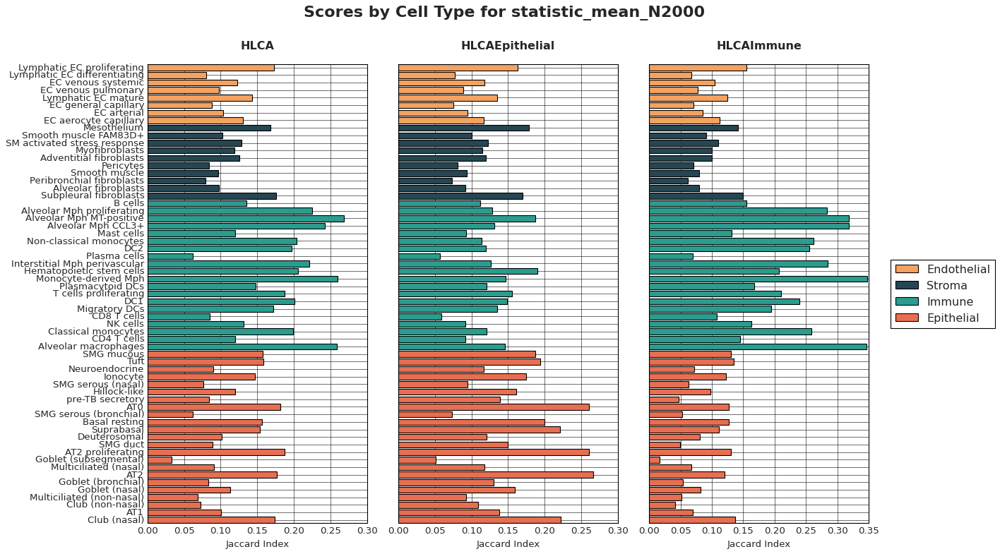

...

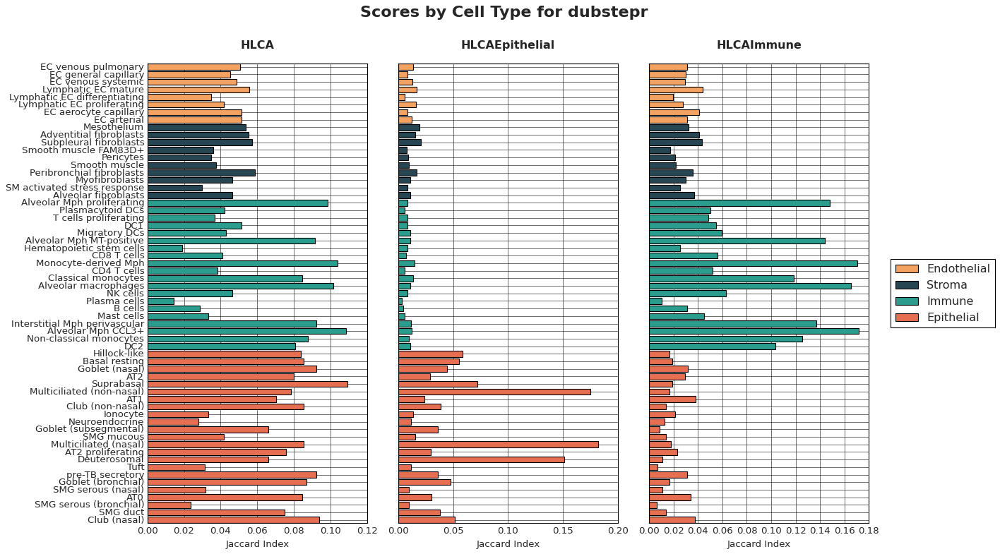

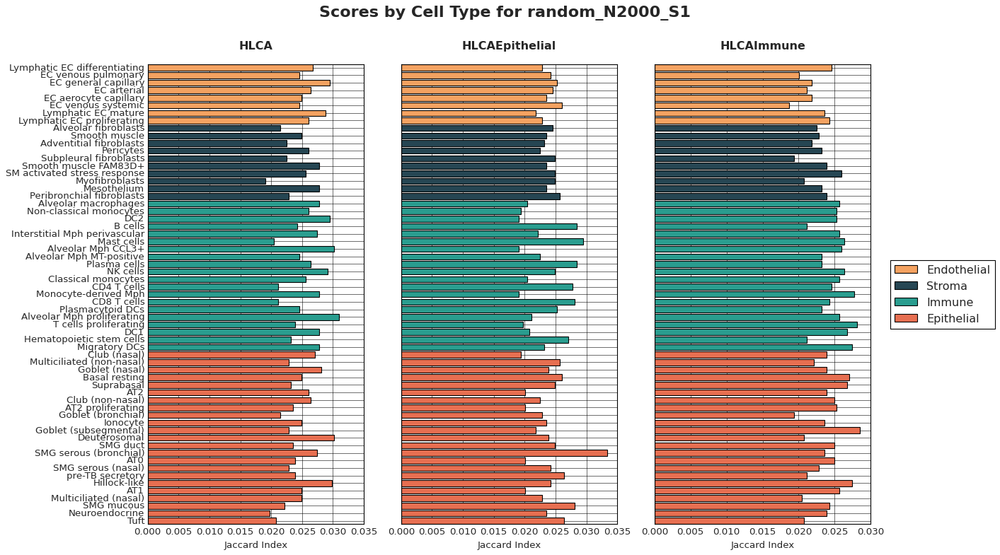

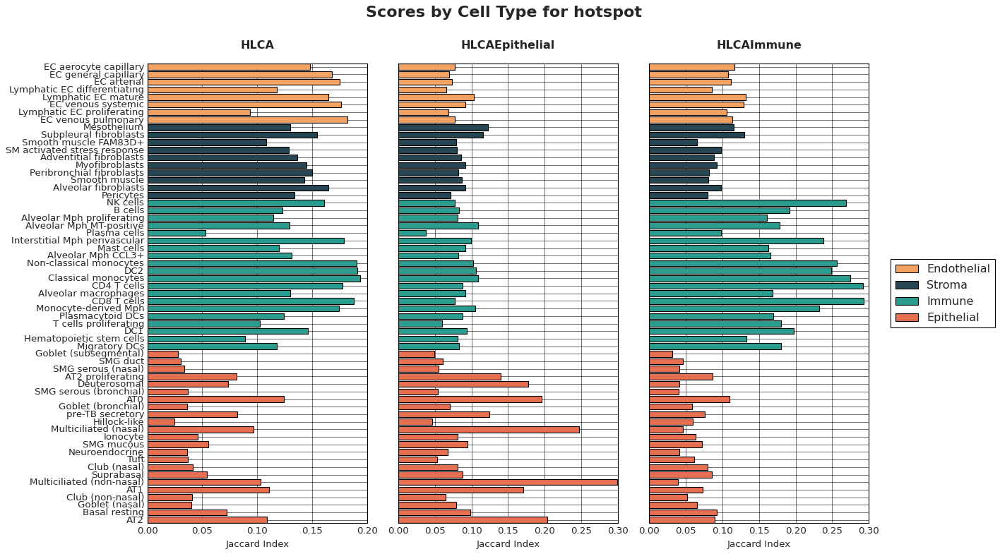

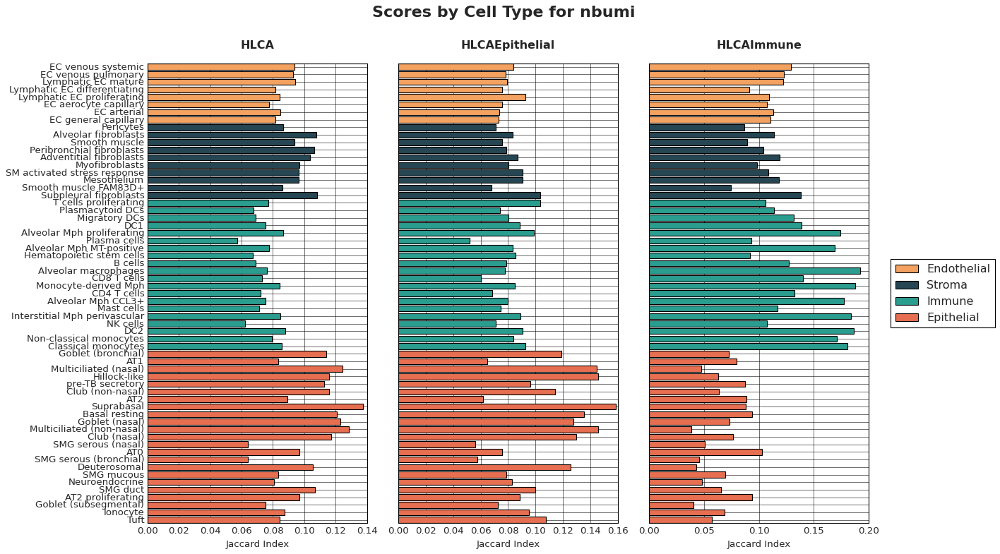

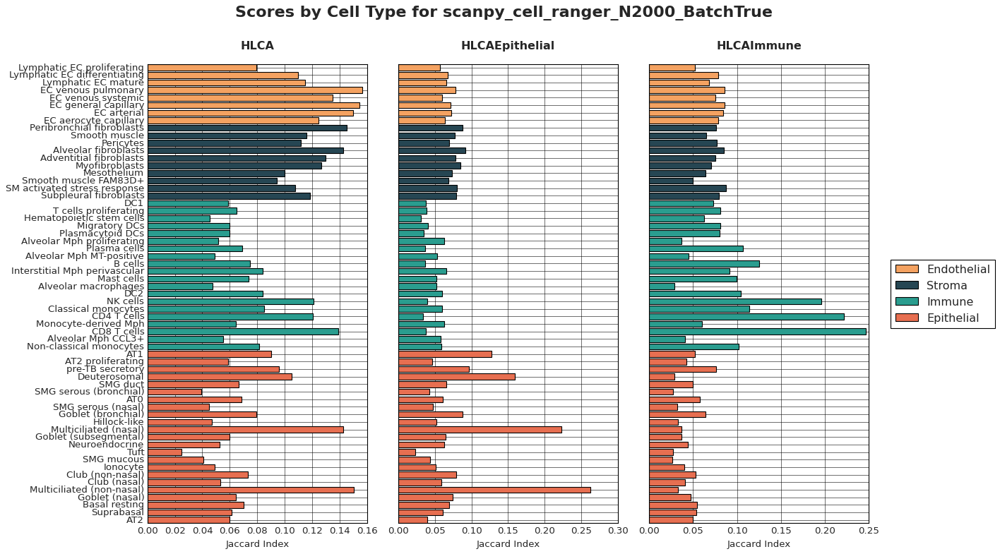

In [175]:
# Visualize jaccard index by cell type
methods = df['method'].unique()
datasets = df['dataset'].unique()

for method in methods:
    fig, axes = plt.subplots(nrows=1, ncols=len(datasets), figsize=(18, 10), sharey=True)
    fig.suptitle(f'Scores by Cell Type for {method}', fontsize=20, fontweight='bold')

    for ax, dataset in zip(axes, datasets):
        subset = df[(df['method'] == method) & (df['dataset'] == dataset)]
        
        bars = ax.barh(subset['cell_type'], subset['score'], color=subset['colors'], edgecolor='black')

        ax.set_title(f'{dataset}', fontweight='bold', pad=20)
        ax.set_xlabel('Jaccard Index')
        ax.set_ylabel('')

    from matplotlib.patches import Patch
    legend_elements = [Patch(facecolor=lineage_colors[key], label=key, edgecolor='black') for key in reversed(lineage_colors)]
    plt.legend(handles=legend_elements, loc='center right', bbox_to_anchor=(1.6, 0.5))

    plt.tight_layout(rect=[0, 0, 1, 0.98])
    plt.show()

### Plot heatmap of overlap scores

In [24]:
df_overlap

,method,dataset,cell_type,score,lineage
0,random_N2000_S5,HLCA,Alveolar macrophages,0.09,Immune
1,random_N2000_S5,HLCA,AT2,0.05,Epithelial
2,random_N2000_S5,HLCA,Suprabasal,0.05,Epithelial
3,random_N2000_S5,HLCA,Basal resting,0.06,Epithelial
4,random_N2000_S5,HLCA,Goblet (nasal),0.05,Epithelial
...,...,...,...,...,...
7864,scanpy_seurat_N2000_BatchFalse,HLCAImmune,Mesothelium,0.31,Stroma
7865,scanpy_seurat_N2000_BatchFalse,HLCAImmune,Tuft,0.05,Epithelial
7866,scanpy_seurat_N2000_BatchFalse,HLCAImmune,Neuroendocrine,0.09,Epithelial
7867,scanpy_seurat_N2000_BatchFalse,HLCAImmune,Hematopoietic stem cells,0.05,Immune


In [25]:
# sort overlap scores
lineage_order = list(df_overlap['lineage'].value_counts().index)
df_overlap['lineage'] = pd.Categorical(df_overlap['lineage'], categories=lineage_order, ordered=True)
df_overlap.sort_values(by=['lineage'], inplace=True)

In [61]:
# save overlap score results
df_overlap.to_csv("/home/icb/raphael.kfuri-rubens/notebooks/feature_selection/feature_overlap_per_cell_type.tsv", sep="\t", index=False)

In [27]:
# make summary table with mean and standard deviation of overlap score
grouped = df_overlap.groupby(['method', 'dataset', 'lineage'])
summary_df = grouped['score'].agg(score_mean='mean', score_std='std').reset_index()
summary_df

/tmp/ipykernel_3280519/3662416006.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = df_overlap.groupby(['method', 'dataset', 'lineage'])


,method,dataset,lineage,score_mean,score_std
0,Brennecke,HLCA,Epithelial,0.425652,0.164007
1,Brennecke,HLCA,Immune,0.473000,0.171437
2,Brennecke,HLCA,Stroma,0.724000,0.113058
3,Brennecke,HLCA,Endothelial,0.756250,0.180866
4,Brennecke,HLCAEpithelial,Epithelial,0.420435,0.203436
...,...,...,...,...,...
511,wilcoxon,HLCAEpithelial,Endothelial,0.321250,0.047641
512,wilcoxon,HLCAImmune,Epithelial,0.241739,0.085899
513,wilcoxon,HLCAImmune,Immune,0.533500,0.157222
514,wilcoxon,HLCAImmune,Stroma,0.275000,0.036591


In [55]:
# save summary table
summary_df.to_csv("/home/icb/raphael.kfuri-rubens/notebooks/feature_selection/feature_overlap_summary.tsv", sep="\t", index=False)

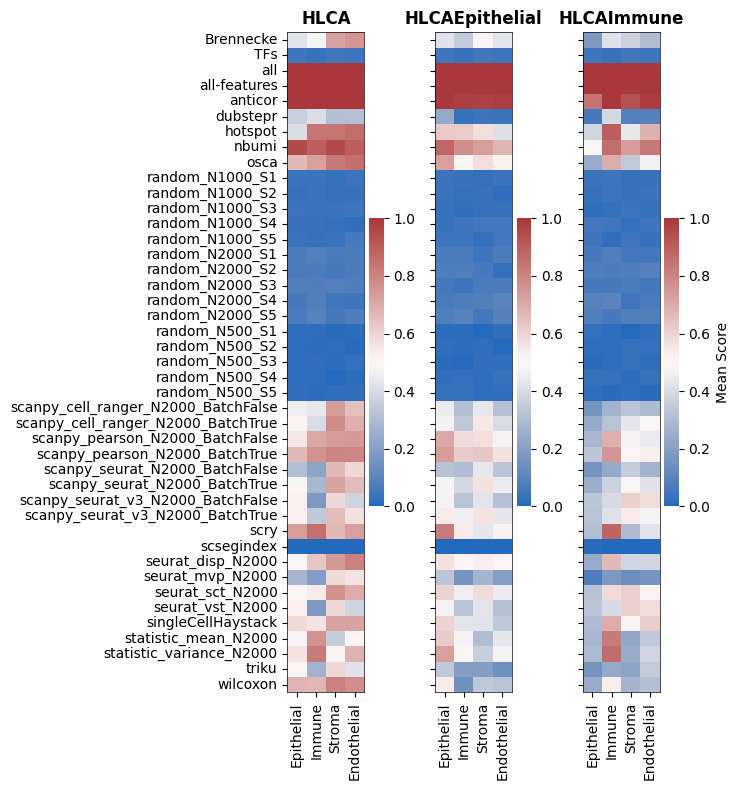

In [52]:
# visualize summary overlap scores as heatmap per dataset/subset
datasets = summary_df['dataset'].unique()

fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(7.5, 8), sharey=True)

for ax, dataset, is_last in zip(axes, datasets, [False, False, True]):
    df_plot = summary_df[summary_df['dataset'] == dataset]
    
    pivot_df = df_plot.pivot(index="method", columns="lineage", values="score_mean")
    
    sns.heatmap(pivot_df, annot=False, cmap='vlag', ax=ax, cbar=True,
                cbar_kws={'label': 'Mean Score'} if is_last else None)
    
    ax.set_title(f"{dataset}", fontweight='bold')

    ax.set_xlabel('')
    ax.set_ylabel('')

    # adding black border around each heatmap
    for _, spine in ax.spines.items():
        spine.set_visible(True)
        spine.set_linewidth(0.5)
        spine.set_edgecolor('black')

plt.tight_layout()
plt.show()

# HLCA - Unseen cell type analysis

## Left out cell types:

- Look at cell types which are left out, see below
- 3 different methods
- Check unseen detection score
- Find methods where
    - 1 method well on full and subsets
    - method which is bad on all

### Full HLCA
- Multiciliated (nasal)
- Club (nasal)
- Goblet (subsegmental)
- SMG serous (nasal)
- SMG serous (bronchial)
- SMG mucous
- EC aerocyte capillary
- Peribronchial fibroblasts
- Smooth muscle
- Smooth muscle FAM83D+
- B cells
- DC2
- Alveolar Mph CCL3+
- Mast cells

### HLCA Immune
- B cells
- DC2
- Alveolar Mph CCL3+
- Mast cells

### HLCA Epithelial
- Multiciliated (nasal)
- Club (nasal)
- Goblet (subsegmental)
- SMG serous (nasal)
- SMG serous (bronchial)
- SMG mucous


### Metods to check:
- Full > Immune/Epithelial: triku
- Epithelial > Full > Immune: seurat_mvp_N2000
- Immune > Full > Epithelial: seurat_disp_N2000

In [2]:
# get paths and constants
models_path = "/lustre/groups/ml01/code/luke.zappia/atlas-feature-selection-benchmark/output/benchmark/integration-models"
datasets = ["HLCA", "HLCAImmune", "HLCAEpithelial"]
methods_of_interest = ["triku", "seurat-mvp-N2000", "seurat-disp-N2000"]
ref_quer = ['scVI-reference-1', 'scVI-mapped-1']

full_left_out = [
    'Multiciliated (nasal)',
    'Club (nasal)',
    'Goblet (subsegmental)',
    'SMG serous (nasal)',
    'SMG serous (bronchial)',
    'SMG mucous',
    'EC aerocyte capillary',
    'Peribronchial fibroblasts',
    'Smooth muscle',
    'Smooth muscle FAM83D+',
    'B cells',
    'DC2',
    'Alveolar Mph CCL3+',
    'Mast cells'
]

immune_left_out = [
    'B cells',
    'DC2',
    'Alveolar Mph CCL3+',
    'Mast cells'
]

epithelial_left_out = [
    'Multiciliated (nasal)',
    'Club (nasal)',
    'Goblet (subsegmental)',
    'SMG serous (nasal)',
    'SMG serous (bronchial)',
    'SMG mucous'
]

## Triku

- Full > Immune/Epithelial: triku


/home/icb/raphael.kfuri-rubens/miniconda3/envs/feature-selection-env/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


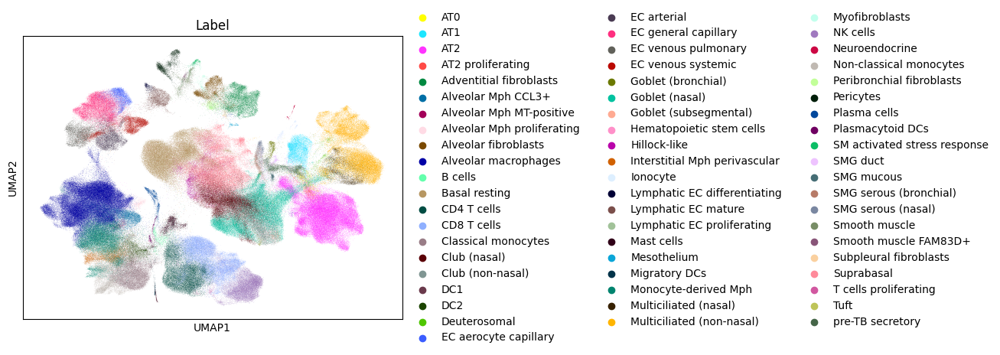

In [3]:
# Full HLCA

# read embeddings of query and reference
adata_full_triku_reference_full = sc.read_h5ad(join(models_path, datasets[0], methods_of_interest[0], ref_quer[0], 'adata.h5ad'))
adata_full_triku_mapped_full = sc.read_h5ad(join(models_path, datasets[0], methods_of_interest[0], ref_quer[1], 'adata.h5ad'))

# concatenate and calculate neighborhood graph and UMAP
triku_adatas_full = {
    'reference': adata_full_triku_reference_full,
    'query': adata_full_triku_mapped_full
}

adata_triku_full = ad.concat(triku_adatas_full, label='mapping')
sc.pp.neighbors(adata_triku_full, use_rep="X_emb")
sc.tl.umap(adata_triku_full)
adata_triku_full.write_h5ad("/home/icb/raphael.kfuri-rubens/notebooks/feature_selection/adata_triku_full.h5ad", compression = "gzip")

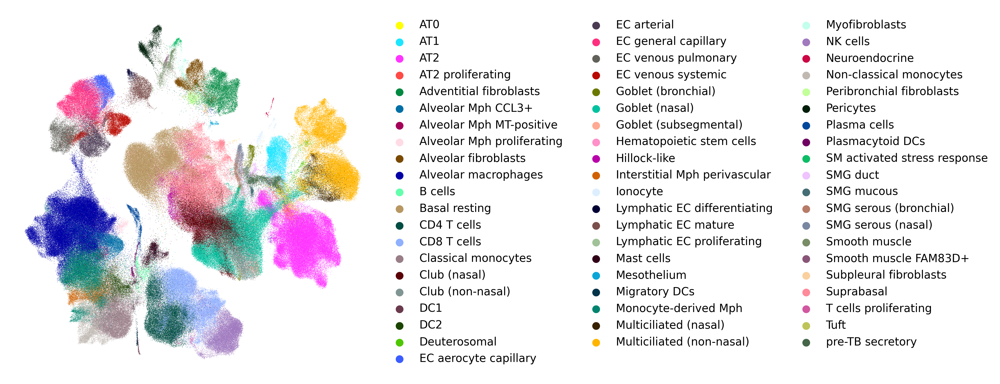

In [200]:
# plot with specific params
with plt.rc_context({"figure.figsize": (6, 6), "figure.dpi": (300)}):
    sc.pl.umap(adata_triku_full, color='Label', frameon=False, title='', size=0.5, save = '_triku_full.pdf')

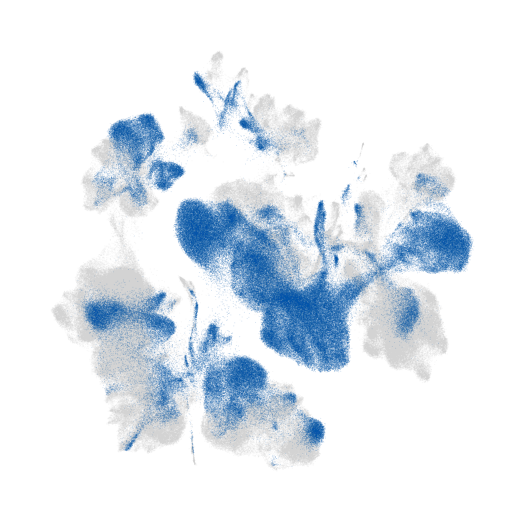

In [201]:
# plot query (blue) and reference (grey)
with plt.rc_context({"figure.figsize": (2, 2), "figure.dpi": (300)}):
    sc.pl.umap(adata_triku_full, color='mapping', palette=['#D3D3D3', '#0055AA'], 
        frameon=False, title='', legend_loc=None, alpha=0.2, save='_triku_full_mapping.pdf'
    )

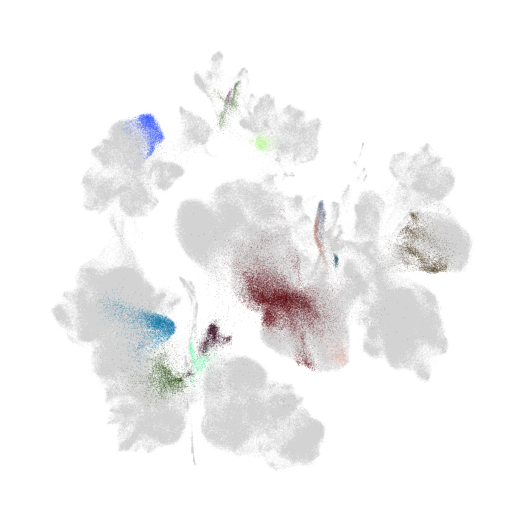

In [202]:
# visualize unseen cell types after mapping
labels = adata_triku_full.obs['Label'].cat.categories
colors = adata_triku_full.uns['Label_colors']

label_color_mapping = pd.DataFrame({
    'Label': labels,
    'Color': colors
})

new_cols = []
for label in label_color_mapping['Label'].tolist():
    if label in full_left_out:
        new_cols.append(label_color_mapping.loc[label_color_mapping['Label'] == label, 'Color'].values[0])
    else:
        new_cols.append('#D3D3D3')

adata_triku_full.obs['Label_mapping'] = adata_triku_full.obs['Label']
adata_triku_full.uns['Label_mapping_colors'] = new_cols

with plt.rc_context({"figure.figsize": (2, 2), "figure.dpi": (300)}):
    sc.pl.umap(adata_triku_full, color='Label_mapping', frameon=False, title='', legend_loc=None, alpha=0.2, save='_triku_full_unseen.pdf')

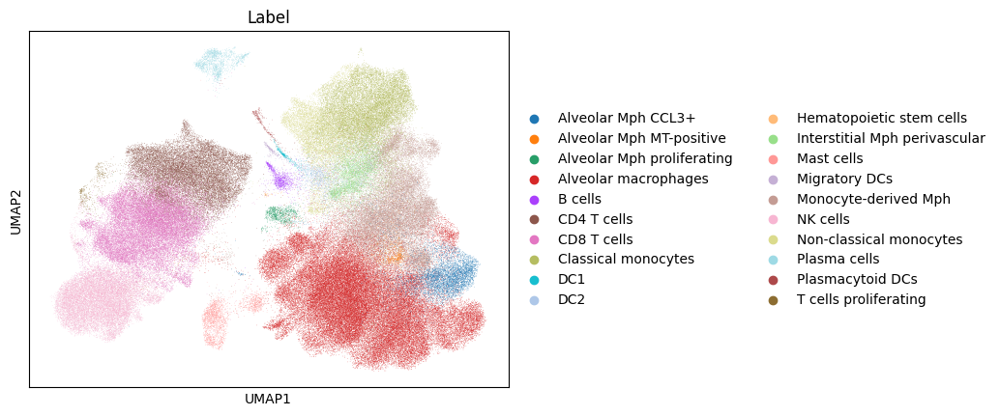

In [4]:
# Immune subset

# read embeddings of query and reference
adata_full_triku_reference_immune = sc.read_h5ad(join(models_path, datasets[1], methods_of_interest[0], ref_quer[0], 'adata.h5ad'))
adata_full_triku_mapped_immune = sc.read_h5ad(join(models_path, datasets[1], methods_of_interest[0], ref_quer[1], 'adata.h5ad'))

# concatenate and calculate neighborhood graph and UMAP
triku_adatas_immune = {
    'reference': adata_full_triku_reference_immune,
    'query': adata_full_triku_mapped_immune
}

adata_triku_immune = ad.concat(triku_adatas_immune, label='mapping')
sc.pp.neighbors(adata_triku_immune, use_rep="X_emb")
sc.tl.umap(adata_triku_immune)
adata_triku_immune.write_h5ad("/home/icb/raphael.kfuri-rubens/notebooks/feature_selection/adata_triku_immune.h5ad", compression = "gzip")

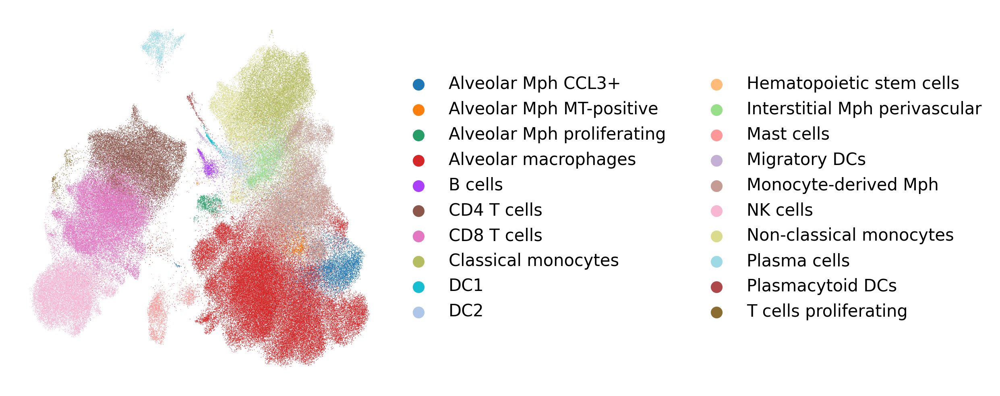

In [203]:
# plot with specific params
with plt.rc_context({"figure.figsize": (4, 4), "figure.dpi": (300)}):
    sc.pl.umap(adata_triku_immune, color='Label', frameon=False, title='', size=0.5, save='_triku_immune.pdf')

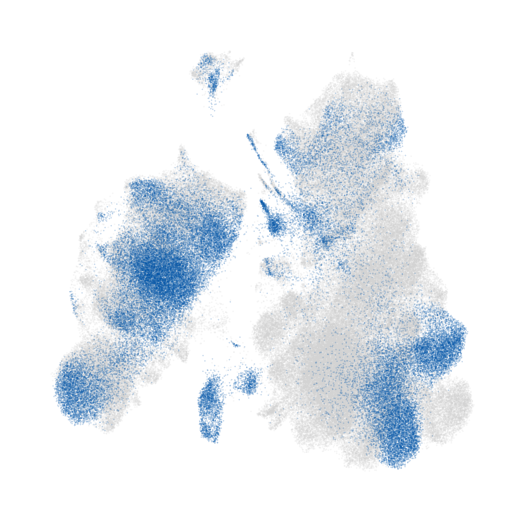

In [204]:
# plot query (blue) and reference (grey)
with plt.rc_context({"figure.figsize": (2, 2), "figure.dpi": (300)}):
    sc.pl.umap(adata_triku_immune, color='mapping', palette=['#D3D3D3', '#0055AA'],
        frameon=False, title='', legend_loc=None, alpha=0.2, save='_triku_immune_mapping.pdf
    )

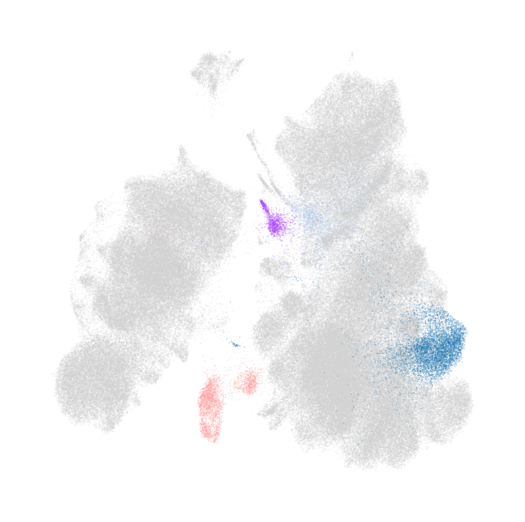

In [205]:
# visualize unseen cell types after mapping
labels = adata_triku_immune.obs['Label'].cat.categories
colors = adata_triku_immune.uns['Label_colors']

label_color_mapping = pd.DataFrame({
    'Label': labels,
    'Color': colors
})

new_cols = []
for label in label_color_mapping['Label'].tolist():
    if label in immune_left_out:
        new_cols.append(label_color_mapping.loc[label_color_mapping['Label'] == label, 'Color'].values[0])
    else:
        new_cols.append('#D3D3D3')

adata_triku_immune.obs['Label_mapping'] = adata_triku_immune.obs['Label']
adata_triku_immune.uns['Label_mapping_colors'] = new_cols

with plt.rc_context({"figure.figsize": (2, 2), "figure.dpi": (300)}):
    sc.pl.umap(adata_triku_immune, color='Label_mapping', frameon=False, title='', legend_loc=None, alpha=0.2, save='_triku_immune_unseen.pdf')

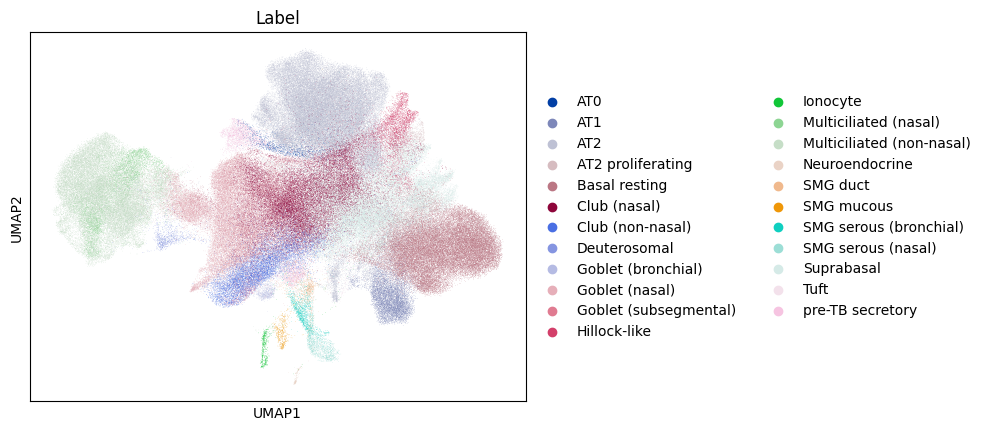

In [5]:
# Epithelial subset

# read embeddings of query and reference
adata_full_triku_reference_epithelial = sc.read_h5ad(join(models_path, datasets[2], methods_of_interest[0], ref_quer[0], 'adata.h5ad'))
adata_full_triku_mapped_epithelial = sc.read_h5ad(join(models_path, datasets[2], methods_of_interest[0], ref_quer[1], 'adata.h5ad'))

# concatenate and calculate neighborhood graph and UMAP
triku_adatas_epithelial = {
    'reference': adata_full_triku_reference_epithelial,
    'query': adata_full_triku_mapped_epithelial
}

adata_triku_epithelial = ad.concat(triku_adatas_epithelial, label='mapping')
sc.pp.neighbors(adata_triku_epithelial, use_rep="X_emb")
sc.tl.umap(adata_triku_epithelial)
adata_triku_epithelial.write_h5ad("/home/icb/raphael.kfuri-rubens/notebooks/feature_selection/adata_triku_epithelial.h5ad", compression = "gzip")

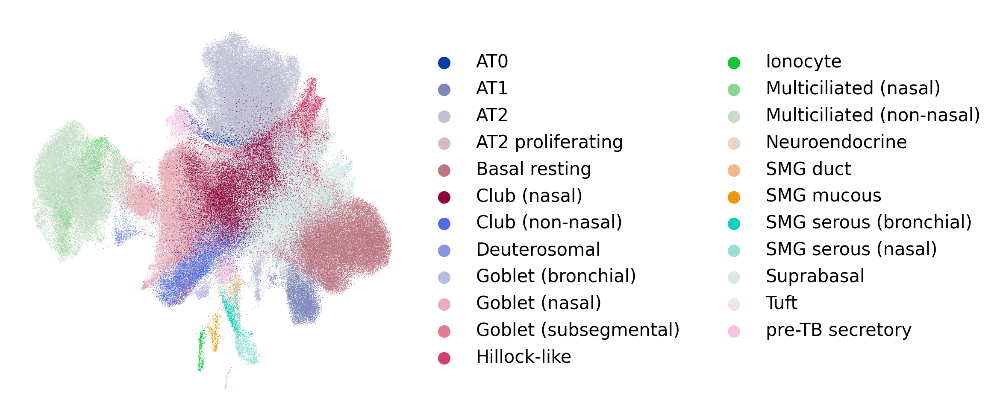

In [206]:
# plot with specific params
with plt.rc_context({"figure.figsize": (4, 4), "figure.dpi": (300)}):
    sc.pl.umap(adata_triku_epithelial, color='Label', frameon=False, title='', size=0.5, save='_triku_epithelial.pdf')

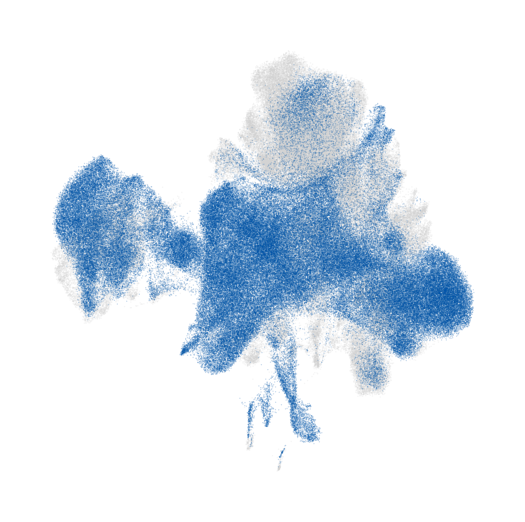

In [207]:
# plot query (blue) and reference (grey)
with plt.rc_context({"figure.figsize": (2, 2), "figure.dpi": (300)}):
    sc.pl.umap(adata_triku_epithelial, color='mapping', palette=['#D3D3D3', '#0055AA'],
        frameon=False, title='', legend_loc=None, alpha=0.2, save='_triku_epithelial_mapping.pdf'
    )

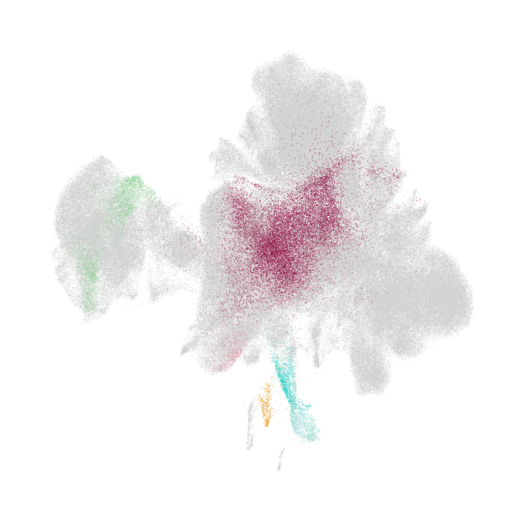

In [208]:
# visualize unseen cell types after mapping
labels = adata_triku_epithelial.obs['Label'].cat.categories
colors = adata_triku_epithelial.uns['Label_colors']

label_color_mapping = pd.DataFrame({
    'Label': labels,
    'Color': colors
})

new_cols = []
for label in label_color_mapping['Label'].tolist():
    if label in epithelial_left_out:
        new_cols.append(label_color_mapping.loc[label_color_mapping['Label'] == label, 'Color'].values[0])
    else:
        new_cols.append('#D3D3D3')

adata_triku_epithelial.obs['Label_mapping'] = adata_triku_epithelial.obs['Label']
adata_triku_epithelial.uns['Label_mapping_colors'] = new_cols

with plt.rc_context({"figure.figsize": (2, 2), "figure.dpi": (300)}):
    sc.pl.umap(adata_triku_epithelial, color='Label_mapping', frameon=False, title='', legend_loc=None, alpha=0.2, save='_triku_epithelial_unseen.pdf')

## seurat-mvp-N2000

- Epithelial > Full > Immune: seurat_mvp_N2000

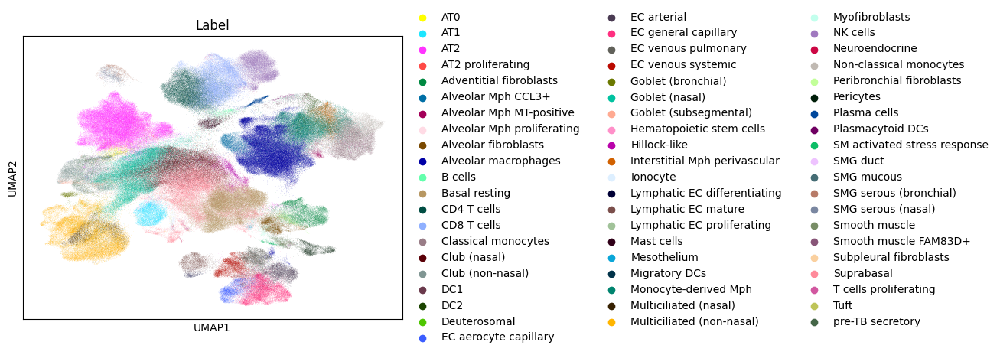

In [6]:
# Full HLCA

# read embeddings of query and reference
adata_full_mvp_reference_full = sc.read_h5ad(join(models_path, datasets[0], methods_of_interest[1], ref_quer[0], 'adata.h5ad'))
adata_full_mvp_mapped_full = sc.read_h5ad(join(models_path, datasets[0], methods_of_interest[1], ref_quer[1], 'adata.h5ad'))

# concatenate and calculate neighborhood graph and UMAP
mvp_adatas_full = {
    'reference': adata_full_mvp_reference_full,
    'query': adata_full_mvp_mapped_full
}

adata_mvp_full = ad.concat(mvp_adatas_full, label='mapping')
sc.pp.neighbors(adata_mvp_full, use_rep="X_emb")
sc.tl.umap(adata_mvp_full)
adata_mvp_full.write_h5ad("/home/icb/raphael.kfuri-rubens/notebooks/feature_selection/adata_mvp_full.h5ad", compression = "gzip")

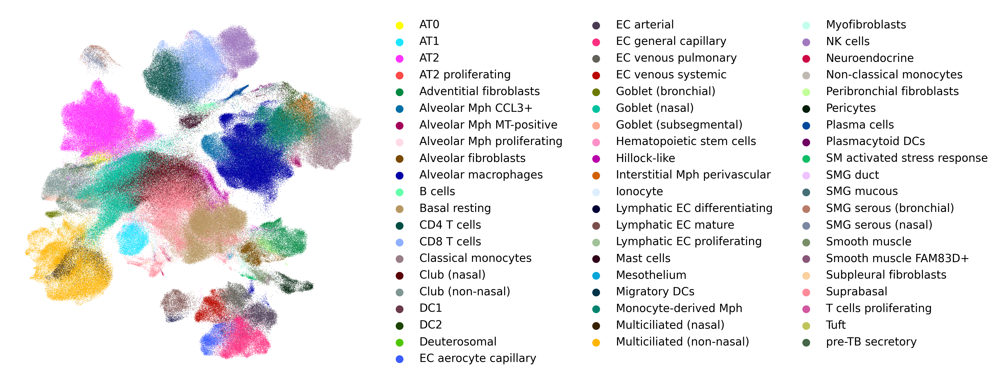

In [209]:
# plot with specific params
with plt.rc_context({"figure.figsize": (6, 6), "figure.dpi": (300)}):
    sc.pl.umap(adata_mvp_full, color='Label', frameon=False, title='', size=0.5, save='_mvp_full.pdf')

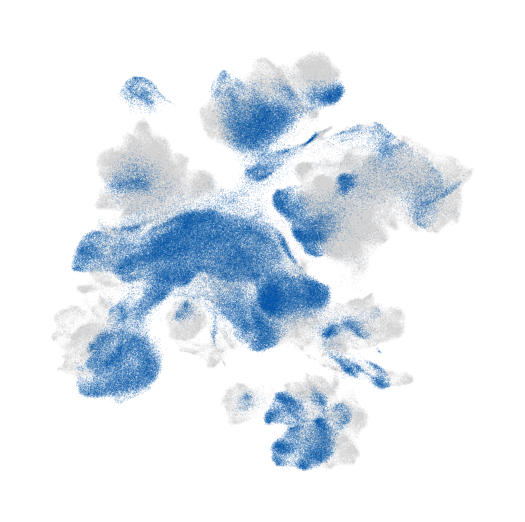

In [210]:
# plot query (blue) and reference (grey)
with plt.rc_context({"figure.figsize": (2, 2), "figure.dpi": (300)}):
    sc.pl.umap(adata_mvp_full, color='mapping', palette=['#D3D3D3', '#0055AA'],
        frameon=False, title='', legend_loc=None, alpha=0.2, save='_mvp_full_mapping.pdf'
    )

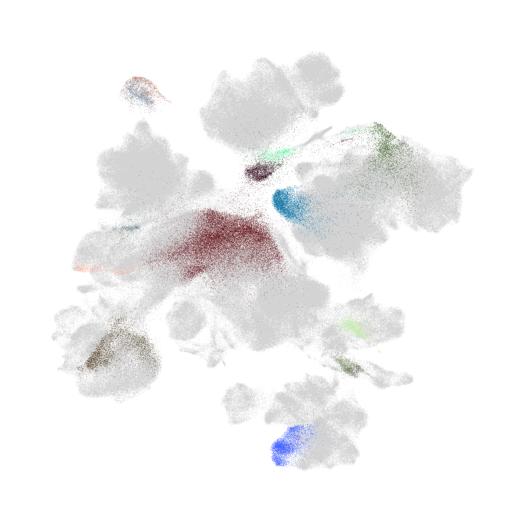

In [211]:
# visualize unseen cell types after mapping
labels = adata_mvp_full.obs['Label'].cat.categories
colors = adata_mvp_full.uns['Label_colors']

label_color_mapping = pd.DataFrame({
    'Label': labels,
    'Color': colors
})

new_cols = []
for label in label_color_mapping['Label'].tolist():
    if label in full_left_out:
        new_cols.append(label_color_mapping.loc[label_color_mapping['Label'] == label, 'Color'].values[0])
    else:
        new_cols.append('#D3D3D3')

adata_mvp_full.obs['Label_mapping'] = adata_mvp_full.obs['Label']
adata_mvp_full.uns['Label_mapping_colors'] = new_cols

with plt.rc_context({"figure.figsize": (2, 2), "figure.dpi": (300)}):
    sc.pl.umap(adata_mvp_full, color='Label_mapping', frameon=False, title='', legend_loc=None, alpha=0.2, save='_mvp_full_unseen.pdf')

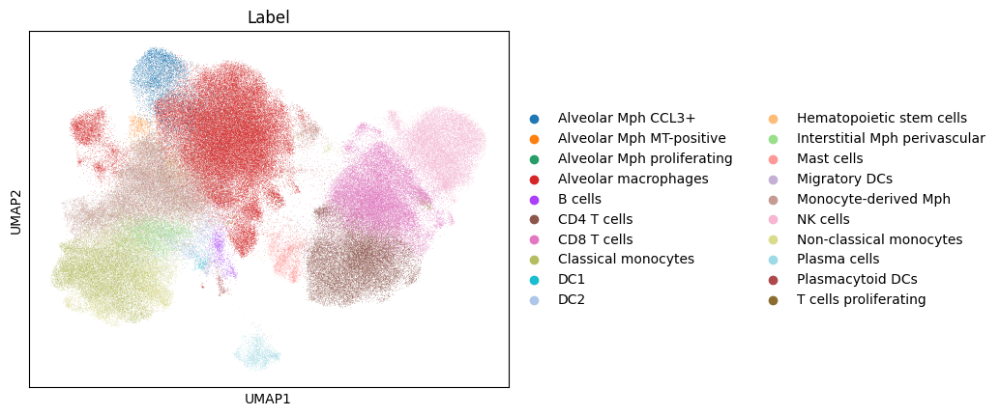

In [7]:
# Immune subset

# read embeddings of query and reference
adata_full_mvp_reference_immune = sc.read_h5ad(join(models_path, datasets[1], methods_of_interest[1], ref_quer[0], 'adata.h5ad'))
adata_full_mvp_mapped_immune = sc.read_h5ad(join(models_path, datasets[1], methods_of_interest[1], ref_quer[1], 'adata.h5ad'))

# concatenate and calculate neighborhood graph and UMAP
mvp_adatas_immune = {
    'reference': adata_full_mvp_reference_immune,
    'query': adata_full_mvp_mapped_immune
}

adata_mvp_immune = ad.concat(mvp_adatas_immune, label='mapping')
sc.pp.neighbors(adata_mvp_immune, use_rep="X_emb")
sc.tl.umap(adata_mvp_immune)
adata_mvp_immune.write_h5ad("/home/icb/raphael.kfuri-rubens/notebooks/feature_selection/adata_mvp_immune.h5ad", compression = "gzip")

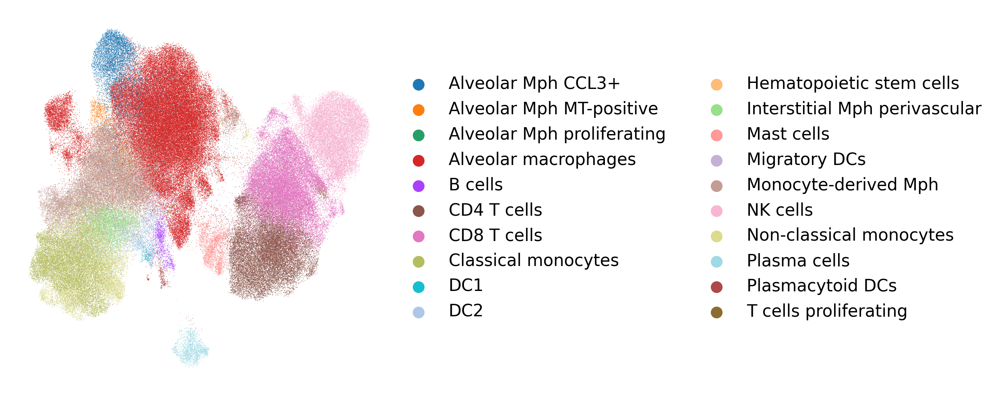

In [212]:
# plot with specific params
with plt.rc_context({"figure.figsize": (4, 4), "figure.dpi": (300)}):
    sc.pl.umap(adata_mvp_immune, color='Label', frameon=False, title='', size=0.5, save='_mvp_immune.pdf')

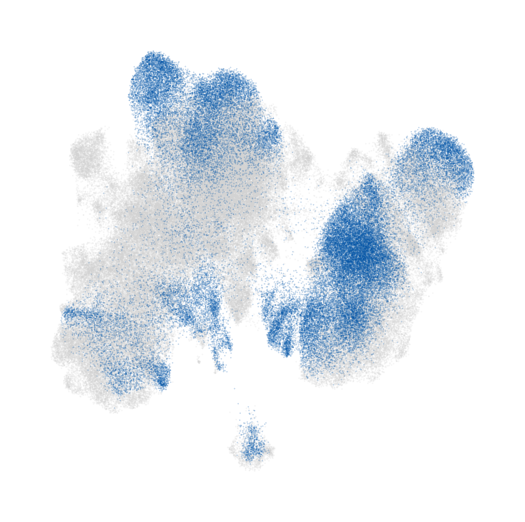

In [213]:
# plot query (blue) and reference (grey)
with plt.rc_context({"figure.figsize": (2, 2), "figure.dpi": (300)}):
    sc.pl.umap(adata_mvp_immune, color='mapping', palette=['#D3D3D3', '#0055AA'],
        frameon=False, title='', legend_loc=None, alpha=0.2, save='_mvp_immune_mapping.pdf'
    )

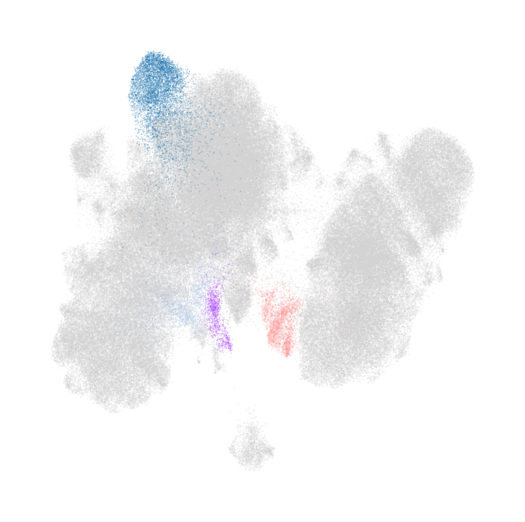

In [214]:
# visualize unseen cell types after mapping
labels = adata_mvp_immune.obs['Label'].cat.categories
colors = adata_mvp_immune.uns['Label_colors']

label_color_mapping = pd.DataFrame({
    'Label': labels,
    'Color': colors
})

new_cols = []
for label in label_color_mapping['Label'].tolist():
    if label in immune_left_out:
        new_cols.append(label_color_mapping.loc[label_color_mapping['Label'] == label, 'Color'].values[0])
    else:
        new_cols.append('#D3D3D3')

adata_mvp_immune.obs['Label_mapping'] = adata_mvp_immune.obs['Label']
adata_mvp_immune.uns['Label_mapping_colors'] = new_cols

with plt.rc_context({"figure.figsize": (2, 2), "figure.dpi": (300)}):
    sc.pl.umap(adata_mvp_immune, color='Label_mapping', frameon=False, title='', legend_loc=None, alpha=0.2, save='_mvp_immune_unseen.pdf')

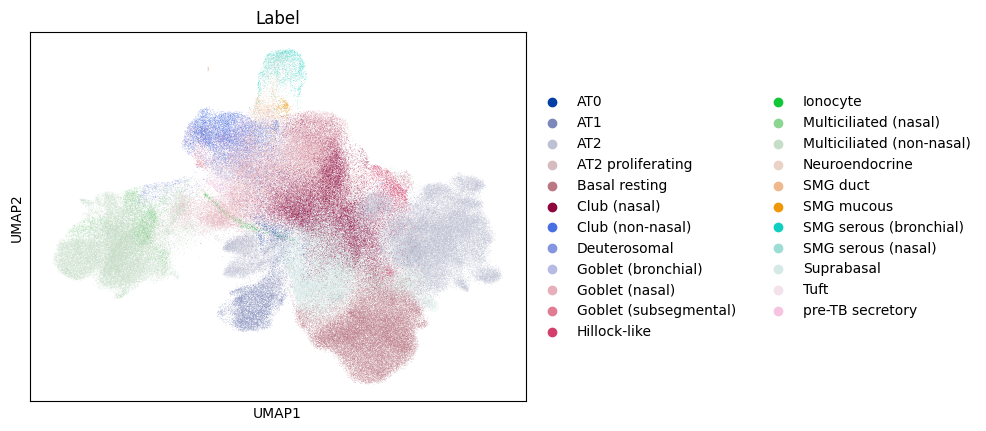

In [8]:
# Epithelial subset

# read embeddings of query and reference
adata_full_mvp_reference_epithelial = sc.read_h5ad(join(models_path, datasets[2], methods_of_interest[1], ref_quer[0], 'adata.h5ad'))
adata_full_mvp_mapped_epithelial = sc.read_h5ad(join(models_path, datasets[2], methods_of_interest[1], ref_quer[1], 'adata.h5ad'))

# concatenate and calculate neighborhood graph and UMAP
mvp_adatas_epithelial = {
    'reference': adata_full_mvp_reference_epithelial,
    'query': adata_full_mvp_mapped_epithelial
}

adata_mvp_epithelial = ad.concat(mvp_adatas_epithelial, label='mapping')
sc.pp.neighbors(adata_mvp_epithelial, use_rep="X_emb")
sc.tl.umap(adata_mvp_epithelial)
adata_mvp_epithelial.write_h5ad("/home/icb/raphael.kfuri-rubens/notebooks/feature_selection/adata_mvp_epithelial.h5ad", compression = "gzip")

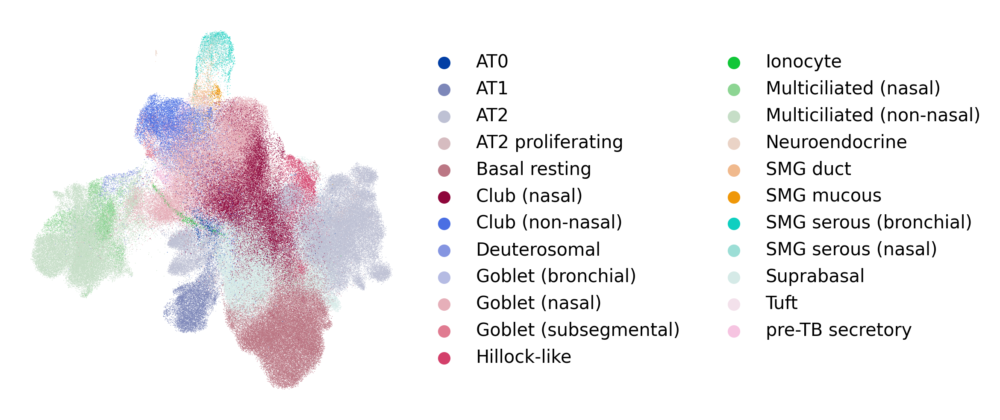

In [215]:
# plot with specific params
with plt.rc_context({"figure.figsize": (4, 4), "figure.dpi": (300)}):
    sc.pl.umap(adata_mvp_epithelial, color='Label', frameon=False, title='', size=0.5, save='_mvp_epithelial.pdf')

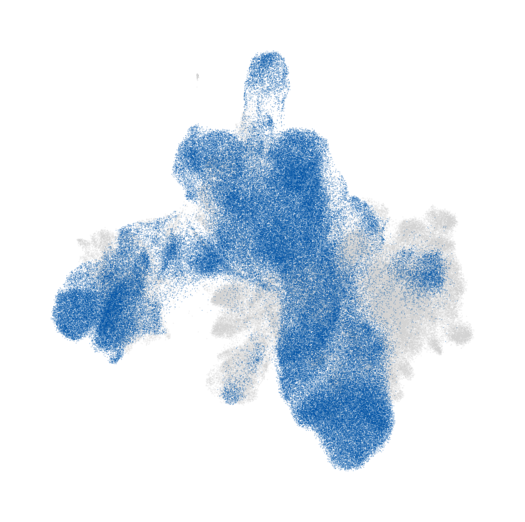

In [216]:
# plot query (blue) and reference (grey)
with plt.rc_context({"figure.figsize": (2, 2), "figure.dpi": (300)}):
    sc.pl.umap(adata_mvp_epithelial, color='mapping', palette=['#D3D3D3', '#0055AA'],
        frameon=False, title='', legend_loc=None, alpha=0.2, save='_mvp_epithelial_mapping.pdf'
    )

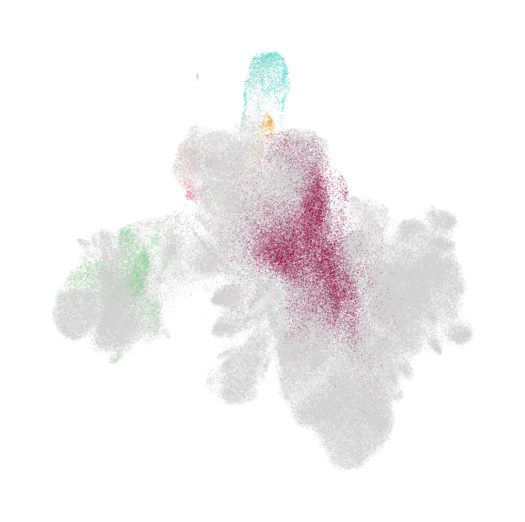

In [217]:
# visualize unseen cell types after mapping
labels = adata_mvp_epithelial.obs['Label'].cat.categories
colors = adata_mvp_epithelial.uns['Label_colors']

label_color_mapping = pd.DataFrame({
    'Label': labels,
    'Color': colors
})

new_cols = []
for label in label_color_mapping['Label'].tolist():
    if label in epithelial_left_out:
        new_cols.append(label_color_mapping.loc[label_color_mapping['Label'] == label, 'Color'].values[0])
    else:
        new_cols.append('#D3D3D3')

adata_mvp_epithelial.obs['Label_mapping'] = adata_mvp_epithelial.obs['Label']
adata_mvp_epithelial.uns['Label_mapping_colors'] = new_cols

with plt.rc_context({"figure.figsize": (2, 2), "figure.dpi": (300)}):
    sc.pl.umap(adata_mvp_epithelial, color='Label_mapping', frameon=False, title='', legend_loc=None, alpha=0.2, save='_mvp_epithelial_unseen.pdf')

## seurat-disp-N2000
- Immune > Full > Epithelial: seurat_disp_N2000

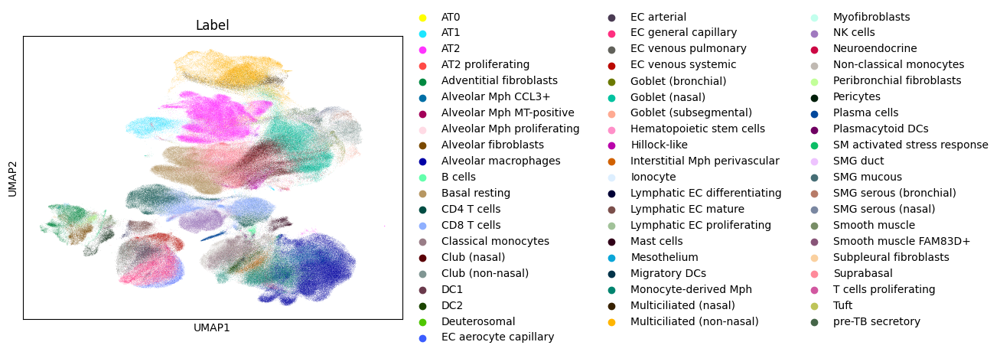

In [11]:
# Full HLCA

# read embeddings of query and reference
adata_full_disp_reference_full = sc.read_h5ad(join(models_path, datasets[0], methods_of_interest[2], ref_quer[0], 'adata.h5ad'))
adata_full_disp_mapped_full = sc.read_h5ad(join(models_path, datasets[0], methods_of_interest[2], ref_quer[1], 'adata.h5ad'))

# concatenate and calculate neighborhood graph and UMAP
disp_adatas_full = {
    'reference': adata_full_disp_reference_full,
    'query': adata_full_disp_mapped_full
}

adata_disp_full = ad.concat(disp_adatas_full, label='mapping')
sc.pp.neighbors(adata_disp_full, use_rep="X_emb")
sc.tl.umap(adata_disp_full)
adata_disp_full.write_h5ad("/home/icb/raphael.kfuri-rubens/notebooks/feature_selection/adata_disp_full.h5ad", compression = "gzip")

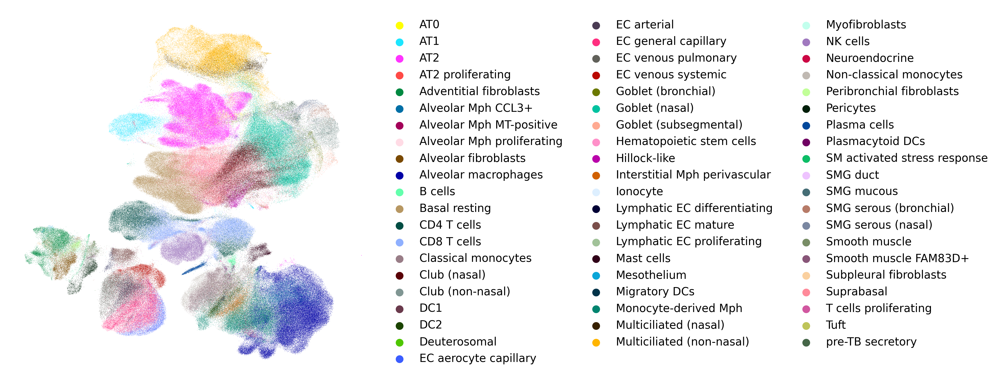

In [218]:
# plot with specific params
with plt.rc_context({"figure.figsize": (6, 6), "figure.dpi": (300)}):
    sc.pl.umap(adata_disp_full, color='Label', frameon=False, title='', alpha=1, save='_disp_full.pdf')

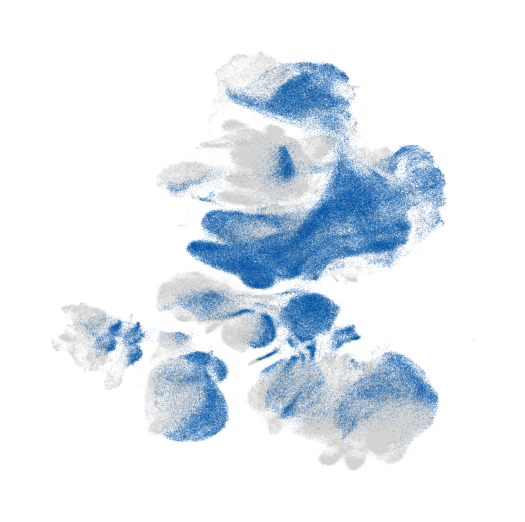

In [219]:
# plot query (blue) and reference (grey)
with plt.rc_context({"figure.figsize": (2, 2), "figure.dpi": (300)}):
    sc.pl.umap(adata_disp_full, color='mapping', palette=['#D3D3D3', '#0055AA'],
        frameon=False, title='', legend_loc=None, alpha=0.2, save='_disp_full_mapping.pdf'
    )

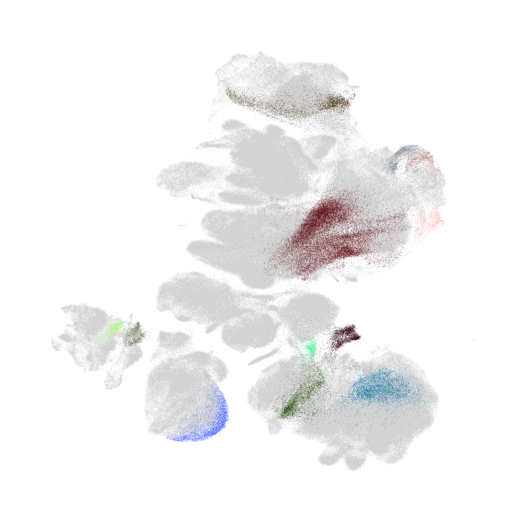

In [220]:
# visualize unseen cell types after mapping
labels = adata_disp_full.obs['Label'].cat.categories
colors = adata_disp_full.uns['Label_colors']

label_color_mapping = pd.DataFrame({
    'Label': labels,
    'Color': colors
})

new_cols = []
for label in label_color_mapping['Label'].tolist():
    if label in full_left_out:
        new_cols.append(label_color_mapping.loc[label_color_mapping['Label'] == label, 'Color'].values[0])
    else:
        new_cols.append('#D3D3D3')

adata_disp_full.obs['Label_mapping'] = adata_disp_full.obs['Label']
adata_disp_full.uns['Label_mapping_colors'] = new_cols

with plt.rc_context({"figure.figsize": (2, 2), "figure.dpi": (300)}):
    sc.pl.umap(adata_disp_full, color='Label_mapping', frameon=False, title='', legend_loc=None, alpha=0.2, save='_disp_full_unseen.pdf')

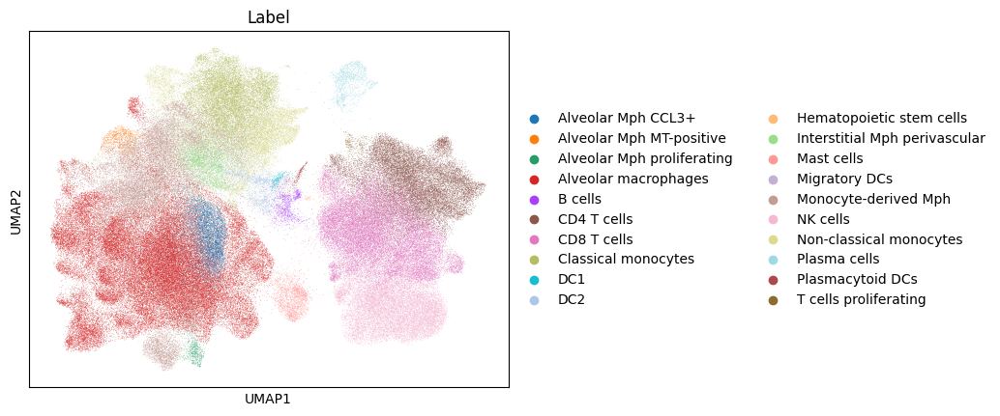

In [9]:
# Immune subset

# read embeddings of query and reference
adata_full_disp_reference_immune = sc.read_h5ad(join(models_path, datasets[1], methods_of_interest[2], ref_quer[0], 'adata.h5ad'))
adata_full_disp_mapped_immune = sc.read_h5ad(join(models_path, datasets[1], methods_of_interest[2], ref_quer[1], 'adata.h5ad'))

# concatenate and calculate neighborhood graph and UMAP
disp_adatas_immune = {
    'reference': adata_full_disp_reference_immune,
    'query': adata_full_disp_mapped_immune
}

adata_disp_immune = ad.concat(disp_adatas_immune, label='mapping')
sc.pp.neighbors(adata_disp_immune, use_rep="X_emb")
sc.tl.umap(adata_disp_immune)
adata_disp_immune.write_h5ad("/home/icb/raphael.kfuri-rubens/notebooks/feature_selection/adata_disp_immune.h5ad", compression = "gzip")

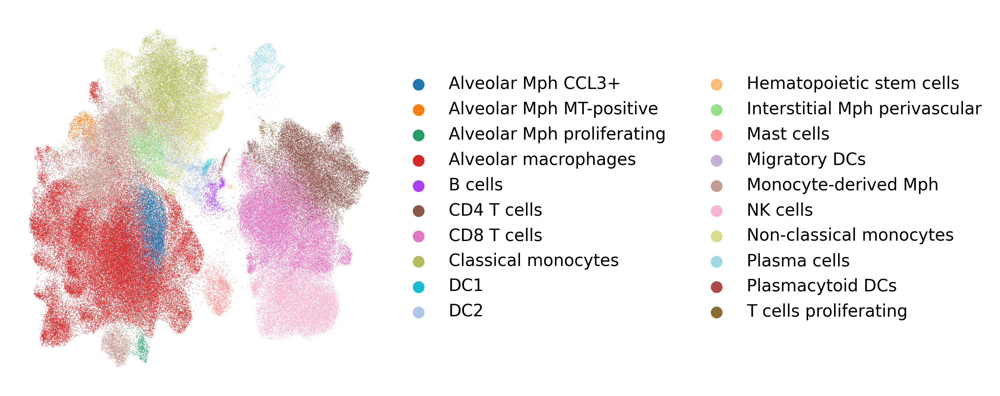

In [221]:
# plot with specific params
with plt.rc_context({"figure.figsize": (4, 4), "figure.dpi": (300)}):
    sc.pl.umap(adata_disp_immune, color='Label', frameon=False, title='', size=0.5, save='_disp_immune.pdf')

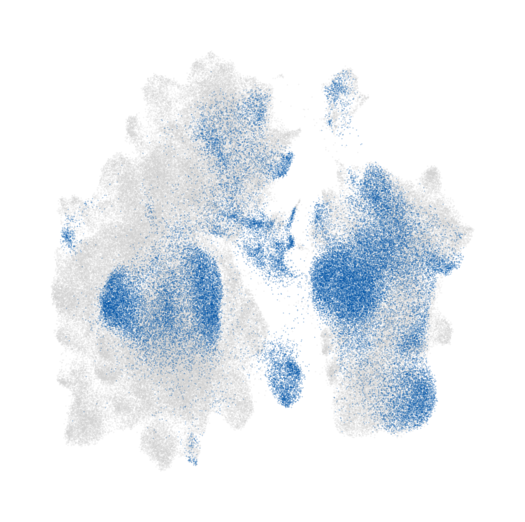

In [222]:
# plot query (blue) and reference (grey)
with plt.rc_context({"figure.figsize": (2, 2), "figure.dpi": (300)}):
    sc.pl.umap(adata_disp_immune, color='mapping', palette=['#D3D3D3', '#0055AA'],
        frameon=False, title='', legend_loc=None, alpha=0.2, save='_disp_immune_mapping.pdf'
    )

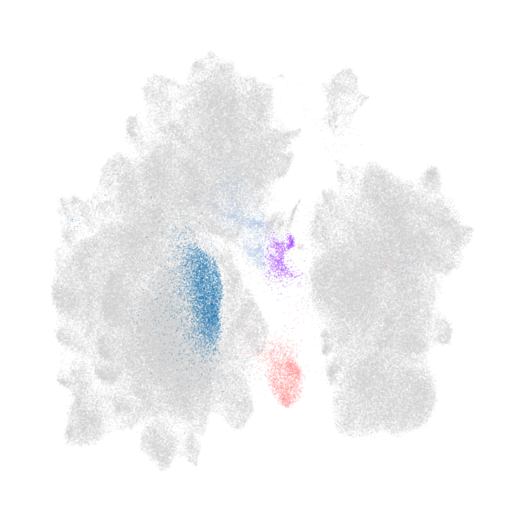

In [223]:
# visualize unseen cell types after mapping
labels = adata_disp_immune.obs['Label'].cat.categories
colors = adata_disp_immune.uns['Label_colors']

label_color_mapping = pd.DataFrame({
    'Label': labels,
    'Color': colors
})

new_cols = []
for label in label_color_mapping['Label'].tolist():
    if label in immune_left_out:
        new_cols.append(label_color_mapping.loc[label_color_mapping['Label'] == label, 'Color'].values[0])
    else:
        new_cols.append('#D3D3D3')

adata_disp_immune.obs['Label_mapping'] = adata_disp_immune.obs['Label']
adata_disp_immune.uns['Label_mapping_colors'] = new_cols

with plt.rc_context({"figure.figsize": (2, 2), "figure.dpi": (300)}):
    sc.pl.umap(adata_disp_immune, color='Label_mapping', frameon=False, title='', legend_loc=None, alpha=0.2, save='_disp_immune_unseen.pdf')

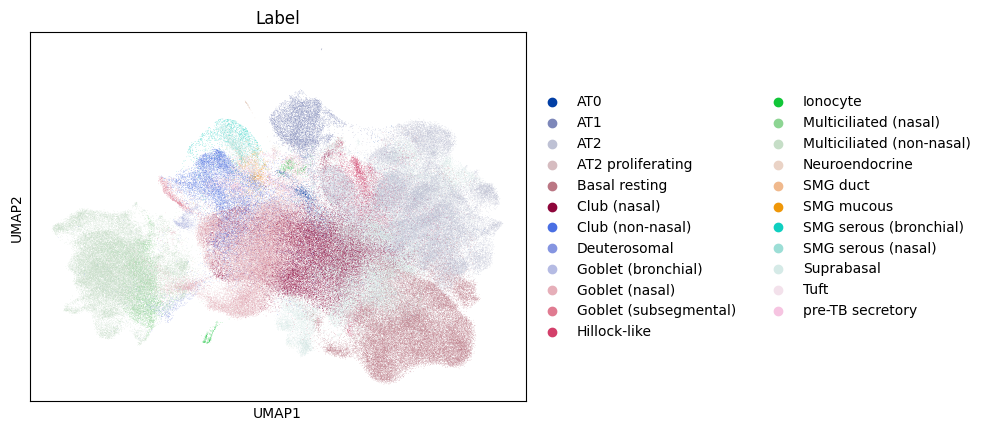

In [10]:
# Epithelial subset

# read embeddings of query and reference
adata_full_disp_reference_epithelial = sc.read_h5ad(join(models_path, datasets[2], methods_of_interest[2], ref_quer[0], 'adata.h5ad'))
adata_full_disp_mapped_epithelial = sc.read_h5ad(join(models_path, datasets[2], methods_of_interest[2], ref_quer[1], 'adata.h5ad'))

# concatenate and calculate neighborhood graph and UMAP
disp_adatas_epithelial = {
    'reference': adata_full_disp_reference_epithelial,
    'query': adata_full_disp_mapped_epithelial
}

adata_disp_epithelial = ad.concat(disp_adatas_epithelial, label='mapping')
sc.pp.neighbors(adata_disp_epithelial, use_rep="X_emb")
sc.tl.umap(adata_disp_epithelial)
adata_disp_epithelial.write_h5ad("/home/icb/raphael.kfuri-rubens/notebooks/feature_selection/adata_disp_epithelial.h5ad", compression = "gzip")

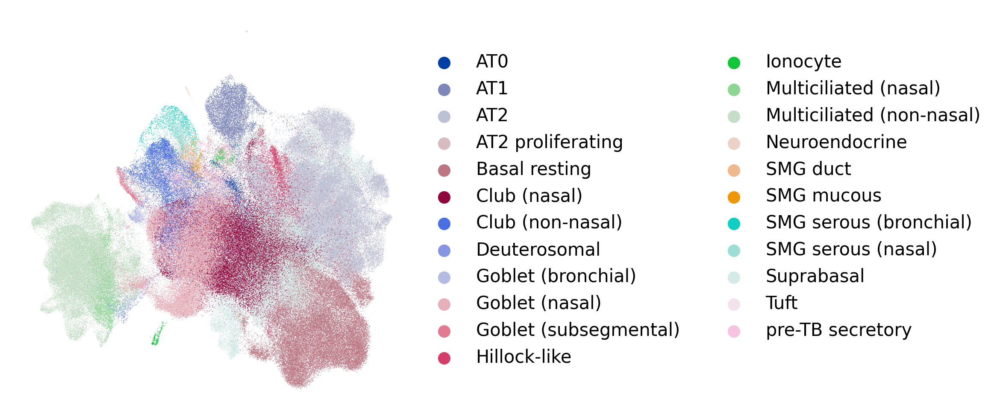

In [224]:
# plot with specific params
with plt.rc_context({"figure.figsize": (4, 4), "figure.dpi": (300)}):
    sc.pl.umap(adata_disp_epithelial, color='Label', frameon=False, title='', size=0.5, save='_disp_epithelial.pdf')

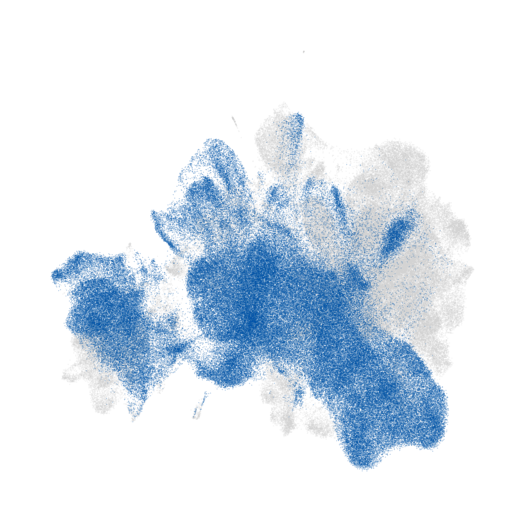

In [225]:
# plot query (blue) and reference (grey)
with plt.rc_context({"figure.figsize": (2, 2), "figure.dpi": (300)}):
    sc.pl.umap(adata_disp_epithelial, color='mapping', palette=['#D3D3D3', '#0055AA'],
        frameon=False, title='', legend_loc=None, alpha=0.2, save='_disp_epithelial_mapping.pdf'
    )

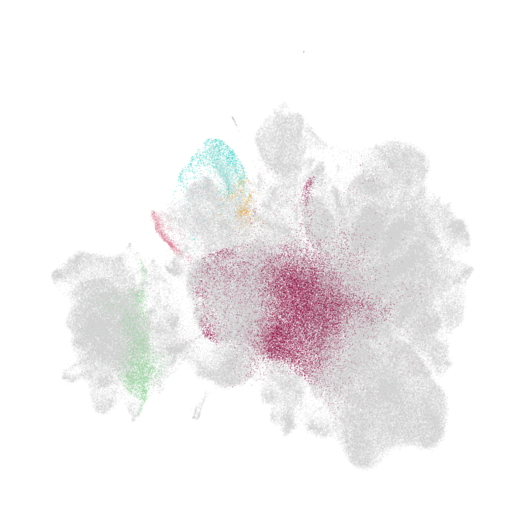

In [226]:
# visualize unseen cell types after mapping
labels = adata_disp_epithelial.obs['Label'].cat.categories
colors = adata_disp_epithelial.uns['Label_colors']

label_color_mapping = pd.DataFrame({
    'Label': labels,
    'Color': colors
})

new_cols = []
for label in label_color_mapping['Label'].tolist():
    if label in epithelial_left_out:
        new_cols.append(label_color_mapping.loc[label_color_mapping['Label'] == label, 'Color'].values[0])
    else:
        new_cols.append('#D3D3D3')

adata_disp_epithelial.obs['Label_mapping'] = adata_disp_epithelial.obs['Label']
adata_disp_epithelial.uns['Label_mapping_colors'] = new_cols

with plt.rc_context({"figure.figsize": (2, 2), "figure.dpi": (300)}):
    sc.pl.umap(adata_disp_epithelial, color='Label_mapping', frameon=False, title='', legend_loc=None, alpha=0.2, save='_disp_epithelial_unseen.pdf')